# <span style="color:navy">Análisis de secuenciación de una sola célula (scRNA-seq) en Hepatoblastoma (HB)</span>

El presente análisis de secuenciación de una sola célula, se basa en los estudios de Bruce Aronow et al., (January 25, 2023), *Modeling Hepatoblastoma: Identification of Distinct Tumor Cell Populations and Key Genetic Mechanisms through Single Cell Sequencing (scRNA-seq)* y de Sonya A MacParland et al. (June 19, 2024), *Single cell RNA sequencing of human liver reveals distinct intrahepatic macrophage populations* obtenidos a través del portal *Human Cell Atlas* (HCA) [https://data.humancellatlas.org/] donde: 

1. **Primer estudio:** Bruce Aronow et al. [https://explore.data.humancellatlas.org/projects/2084526b-a66f-4c40-bb89-6fd162f2eb38
 ], se descargaron los archivos de matriz 10X con un subconjunto de muestra: 2 muestras de hígado sano (control) y 5 muestras de tumor de hepatoblastoma con el tipo de archivo *tar.gz* que contiene 14 archivos (2,63 GB).
2. **Segundo estudio:** Sonya A MacParland et al. [https://explore.data.humancellatlas.org/projects/4d6f6c96-2a83-43d8-8fe1-0f53bffd4674 ], se descargaron los archivos en formato *loom* que contiene 6 archivos (7,67 GB) donde se seleccionaron 5 muestras tumorales y 2 controles.

Después de la descarga de los archivos y antes de preprocesar los datos, se limpian los datos para trabajar solo con el número de genes (n_genes), identificadores de genes y el número de células (n_cells).

-------
**Esquema general del flujo de trabajo de análisis de RNA-seq de una sola célula**

[Malte, D. L. & Fabián, J. Th. (2019) *Current best practices in single‐cell RNA‐seq analysis: a tutorial* Mol Syst Biol, 15: e8746 https://doi.org/10.15252/msb.20188746 ]

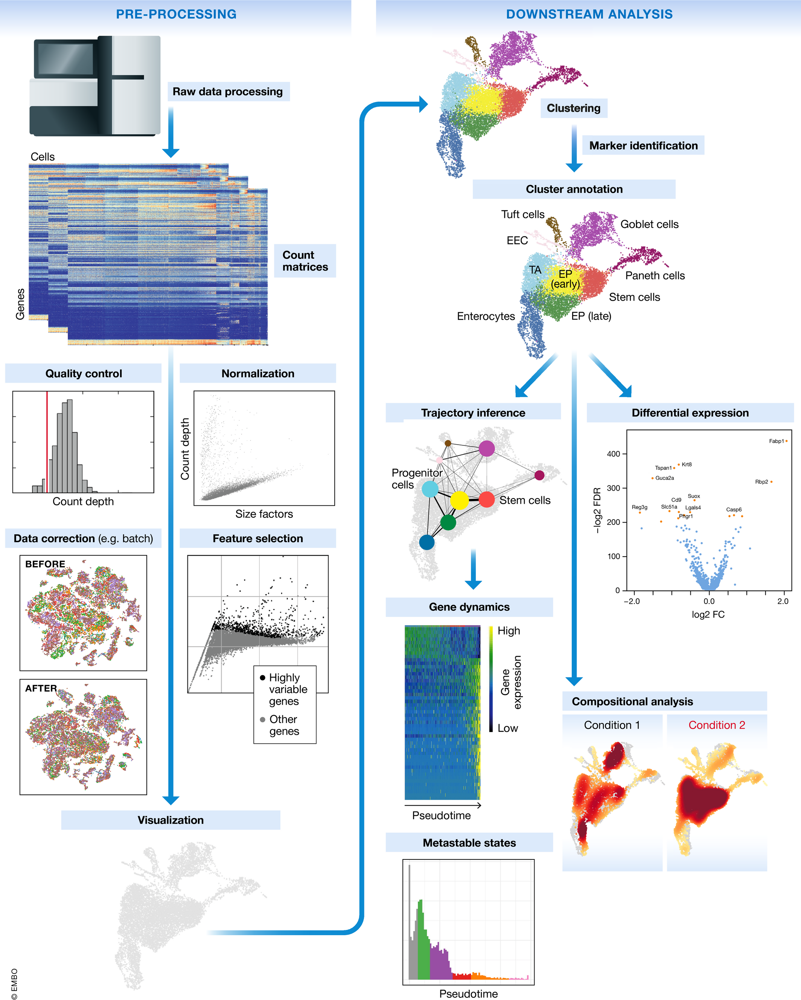

------------
**<span style="color:steelblue">Etapas de los datos preprocesados</span>**

1. **Etapas de Preprocesamiento de scRNA-seq**: El preprocesamiento de datos se divide en cinco etapas: (i) datos sin procesar, (ii) normalizados, (iii) corregidos, (iv) con características seleccionadas y (v) con dimensionalidad reducida. Estas etapas se agrupan en tres capas: datos medidos, datos corregidos y datos reducidos, adaptándose según la aplicación posterior.

2. **Capas de Preprocesamiento**:
   - **Datos Medidos**: Incluyen datos sin procesar y normalizados que conservan ceros.
   - **Datos Corregidos**: Ajustan la variabilidad no deseada y se consideran la versión “limpia” más cercana a la señal biológica.
   - **Datos Reducidos**: Resumen los datos para enfatizar los aspectos dominantes y se usan en visualización y métodos exploratorios.

| Capa de preprocesamiento | Etapa del procesamiento de datos | Aplicaciones apropiadas |
|--------------------------|-------------------|-----------|
| Mesurado                 | 1) Crudo          | Pruebas estadísticas (Expresión diferencial: genes marcadores, genes sobre condición, genes sobre tiempo)   |
|      | 2) Normalizado (+ transformado logarítmicamente) |                 |
| Corregido	               | 3.1) Corregido (corrección técnica) | Comparación visual de datos (trazado) |
|        | 3.2) Corregido (corrección biológica) | Preprocesamiento para inferencia de trayectoria |
| Reducido | 4) Característica seleccionada | Visualización, inferencia de trayectoria |
|     | 5) Dimensionalidad reducida (resumida) | Visualización, agrupamiento, inferencia de gráficos KNN, inferencia de trayectoria |


3. **Usos Específicos**:
   - **Datos Reducidos**: Aptos para métodos de análisis como agrupamiento, visualización y análisis de trayectorias.
   - **Datos Medidos**: Ideales para pruebas estadísticas de expresión diferencial, ya que evitar la corrección excesiva permite estimar la varianza de fondo con mayor precisión.
   - **Datos Corregidos**: Más útiles para la inspección visual, minimizando sesgos de ruido técnico, pero se debe tener cuidado al interpretar correcciones de covariables biológicas.

4. **<span style="color:indianred">Recomendaciones y Precauciones:</span>** 
   - Usar datos medidos para análisis estadísticos.
   - Emplear datos corregidos para comparación visual.
   - Aplicar datos reducidos para análisis exploratorio de la estructura biológica subyacente.
  
5. **Pruebas Diferenciales**: Es preferible usar datos medidos en pruebas de expresión diferencial, ya que las correcciones excesivas pueden introducir sesgos en la interpretación de la varianza y en el tamaño del efecto de las señales biológicas.

---------
## <span style="color:dodgerblue">1. Loading and writing </span>

### <span style="color:navy">1.0 Configuración del entorno y datos</span>

Cargamos las librerias necesarias en Python. La API de Scanpy proporciona acceso a un conjunto completo de herramientas, que utiliza bibliotecas como NumPy y SciPy, mientras que Pandas facilita la importación de datos y gestiona las estructuras de datos, particularmente el módulo AnnData. Para las visualizaciones, se deben importar Matplotlib y Seaborn.

In [1]:
#Para descargas
import gdown, os, gzip, shutil

# Gestión básica de datos y representación gráfica
import pandas as pd
import numpy as np
from scipy import sparse
import matplotlib.pyplot as plt
import os

# Scanpy fundamentals
import anndata as ad
import scanpy as sc
import seaborn as sb

# sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(figsize=(6, 6))
import scvi

/home/mcgonzalez/miniconda3/envs/servicio/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


----------
### <span style="color:navy">1.1 Carga de las muestras control de hígado sano</span>
Estas muestras corresponden a las del **segundo estudio**: Sonya A MacParland et al. [https://explore.data.humancellatlas.org/projects/4d6f6c96-2a83-43d8-8fe1-0f53bffd4674 ], que son archivos en formato *loom* que contiene 6 archivos (7,67 GB); 5 muestras tumorales y 2 controles.

**Download via curl** --> Species: Homo sapiens

File Type:
| Name      | File Count | File Size |
|-----------|------------|-----------|
| loom      | 6          | 7.67 GB   |

In [2]:
pwd # muestra la ruta del directorio en el que me encuentro en este momento.

'/home/mcgonzalez/Servicio_Social/Notebooks'

------------
**`%cd`**: Este es un "magic command" de Jupyter que cambia el directorio de trabajo actual en el entorno del cuaderno.

En este caso, nos movemos a la carpeta en donde guardamos los archivos de las muestras en formato *loom*.

In [3]:
%cd /home/mcgonzalez/Servicio_Social/Data/loom_files

/home/mcgonzalez/Servicio_Social/Data/loom_files


**Formatos de archivos de entrada**

| Nombre                           | Extensión |
|---------------------------------|-----------|
| 10x hdf5                        | .hdf5     |
| R Data Format                   | .rds      |
| AnnData Object                  | .h5ad     |
| Loom                            | .loom     |
| Text-based Market Exchange Format (MEX) | .mtx      |

----------
Para cada uno de los archivos de las muestras vamos a realizar lo siguiente:

**`sc.read_loom`**: Esta función de **Scanpy** carga datos desde un archivo en formato **LOOM**. El formato **LOOM** es adecuado para almacenar grandes matrices dispersas, como las que se generan en secuenciación de ARN unicelular.

**`var_names='gene_symbols'`**: El parámetro **`var_names`** especifica qué columna del archivo LOOM debe utilizarse para los nombres de las variables (en este caso, los **genes**), **`'gene_symbols'`** indica que los nombres de los genes que se utilizarán como etiquetas para las variables en el objeto de datos cargado.
**`adata1`**: La salida de la función se guarda en **`adata1`**, que es un objeto **AnnData**. Este tipo de objeto es el estándar en **Scanpy** para representar y manipular datos de expresión génica, permitiendo almacenar no solo la matriz de expresión, sino también metadatos y anotaciones adicionales (tanto de células como de genes).

In [4]:
adata1 = sc.read_loom('02f207ae-217b-42ce-9733-c03e61541fcc.loom', var_names='gene_symbols')

/home/mcgonzalez/miniconda3/envs/servicio/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


----------
El comando `adata1.var_names_make_unique()` se utiliza para asegurarse de que los nombres de las variables (en este caso, los **genes**) en el objeto `AnnData` (almacenado en `adata1`) sean únicos.

**¿Por qué es importante?**
En análisis de secuenciación de ARN unicelular, es común tener genes repetidos debido a errores en la anotación o porque diferentes transcritos se mapearon al mismo nombre. Hacer que los nombres de las variables sean únicos es importante para evitar confusiones durante el análisis, especialmente en la identificación de la estructura celular como la normalización, agrupación y anotación de los datos.

In [5]:
adata1.var_names_make_unique()

-----------
Las funciones `sc.pp.filter_genes` y `sc.pp.filter_cells` son pasos importantes en la preprocesamiento de datos de secuenciación de ARN unicelular (scRNA-seq). Estas funciones permiten filtrar genes y células según ciertos criterios, ayudando a limpiar y mejorar la calidad de los datos antes del análisis.

**`sc.pp.filter_genes(adata1, min_cells=10)`**: Filtra los genes que tienen una expresión extremadamente baja o nula en la mayoría de las células. El parámetro **`min_cells=10`** indica que solo se conservarán los genes que están expresados en al menos 10 células; si un gen no se expresa en al menos 10 células, se eliminará del objeto `adata1`. Esto ayuda a reducir el ruido y la complejidad en los datos al eliminar genes que probablemente no sean relevantes, ya que solo se expresan en un número muy pequeño de células.

**`sc.pp.filter_cells(adata1, min_genes=200)`**: Filtra las células que tienen una cantidad extremadamente baja de genes expresados. El parámetro **`min_genes=200`** indica que solo se conservarán las células que expresen al menos 200 genes diferentes. Las células que expresan menos de 200 genes serán eliminadas de `adata1`. En general, este filtro elimina células que pueden ser de baja calidad o "muertas", que típicamente tienen muy poca actividad transcripcional. Mantener solo células con un número significativo de genes expresados asegura que los datos sean más fiables.

Este proceso de filtrado es importante para garantizar la calidad de los datos y evitar que datos ruidosos o irrelevantes interfieran en los análisis posteriores, como la normalización, la detección de clústeres o la identificación de poblaciones celulares.

In [6]:
sc.pp.filter_genes(adata1, min_cells =10) # Filtras los genes eliminando aquellos que se expresan en muy pocas células (menos de 10).
sc.pp.filter_cells(adata1, min_genes =200) # Filtras las células eliminando aquellas que expresan pocos genes (menos de 200).

In [7]:
adata1 # muestra el contenido del AnnData

AnnData object with n_obs × n_vars = 5059 × 18023
    obs: 'antisense_reads', 'cell_barcode_fraction_bases_above_30_mean', 'cell_barcode_fraction_bases_above_30_variance', 'cell_names', 'duplicate_reads', 'emptydrops_FDR', 'emptydrops_IsCell', 'emptydrops_Limited', 'emptydrops_LogProb', 'emptydrops_PValue', 'emptydrops_Total', 'fragments_per_molecule', 'fragments_with_single_read_evidence', 'genes_detected_multiple_observations', 'genomic_read_quality_mean', 'genomic_read_quality_variance', 'genomic_reads_fraction_bases_quality_above_30_mean', 'genomic_reads_fraction_bases_quality_above_30_variance', 'input_id', 'molecule_barcode_fraction_bases_above_30_mean', 'molecule_barcode_fraction_bases_above_30_variance', 'molecules_with_single_read_evidence', 'n_fragments', 'n_genes', 'n_mitochondrial_genes', 'n_mitochondrial_molecules', 'n_molecules', 'n_reads', 'noise_reads', 'pct_mitochondrial_molecules', 'perfect_cell_barcodes', 'perfect_molecule_barcodes', 'reads_mapped_exonic', 'reads_map

-------------
- **`adata1.obs = adata1.obs[['n_genes']]`**: Limita los metadatos de las células solo a la información relevante sobre el número de genes expresados. `adata1.obs` contiene metadatos sobre las observaciones, que en este caso son las **células**; es un `DataFrame` de pandas que incluye información como el número de genes expresados en cada célula, entre otros atributos, `adata1.obs[['n_genes']]` selecciona y conserva solo la columna llamada `'n_genes'` en `adata1.obs`; que contiene el número de genes expresados en cada célula y elimina cualquier otra columna que estuviera en el `DataFrame`.

- **`cols_to_keep = ['Gene', 'ensembl_ids', 'n_cells']`**: Aquí definimos una lista de columnas `['Gene', 'ensembl_ids', 'n_cells']` que queremos conservar en los metadatos de las variables (genes). Estas columnas representan: `Gene`; nombres de los genes, `ensembl_ids`; identificadores únicos de los genes en el formato de Ensembl y `n_cells`; número de células en las que se expresa cada gen.
  
- **`adata1.var = adata1.var[cols_to_keep]`**: Quiere decir que `adata1.var` contiene metadatos sobre las **variables**; que en este caso son los **genes**, mientras que `adata1.var[cols_to_keep]` selecciona solo las columnas especificadas en `cols_to_keep` y descarta las demás. Esto asegura que los metadatos de los genes estén limitados a las columnas "Gene", "ensembl_ids" y "n_cells".
   
- **`adata1.var.rename(columns={'ensembl_ids': 'gene_ids'}, inplace=True)`**: Aquí `adata1.var.rename(columns={'ensembl_ids': 'gene_ids'})` renombra la columna `ensembl_ids` a `gene_ids` en `adata1.var` y `inplace=True` realiza el cambio directamente en el `DataFrame` de `adata1.var` sin necesidad de crear una copia.

- **`adata1.var.set_index('Gene', inplace=True)`**: En este caso, `set_index('Gene')` establece la columna `Gene` como el índice del `DataFrame` de `adata1.var`; esto significa que los nombres de los genes serán utilizados como los identificadores principales para las filas, mientras que `inplace=True` realiza el cambio en el `DataFrame` original de `adata1.var` sin generar una copia.

- **`adata1.var.index.name = None`**: Esta línea elimina el nombre del índice del `DataFrame`. Es decir, después de establecer la columna `Gene` como índice, el índice normalmente tendría el nombre `'Gene'`. Al establecer `index.name = None`, eliminamos esa etiqueta para que no se muestre.

In [8]:
adata1.obs = adata1.obs[['n_genes']]
cols_to_keep = ['Gene', 'ensembl_ids', 'n_cells']
adata1.var = adata1.var[cols_to_keep]

adata1.var.rename(columns={'ensembl_ids': 'gene_ids'}, inplace=True)

adata1.var.set_index('Gene', inplace=True)
adata1.var.index.name = None

--------
**`adata1.var_names_make_unique()`** se asegura de que los nombres de las variables (en este caso, los **genes**) en el objeto `adata1` sean únicos. Este paso es necesario porque, en ocasiones, los nombres de los genes pueden repetirse en los datos de secuenciación unicelular, lo que puede causar problemas en los análisis posteriores.

- `adata1.var_names_make_unique()`: Este método revisa los nombres de los genes almacenados en **`adata1.var_names`** (que normalmente es el índice del `DataFrame` de metadatos de los genes).Si encuentra duplicados, los hace únicos automáticamente añadiendo un sufijo como `"_1"`, `"_2"`, etc., a los nombres repetidos.

In [9]:
adata1.var_names_make_unique()

In [10]:
adata1

AnnData object with n_obs × n_vars = 5059 × 18023
    obs: 'n_genes'
    var: 'gene_ids', 'n_cells'

-----
Repitiendo el mismo procedimiento con el resto de archivos de muestras en formato *loom*:

In [11]:
adata2 = sc.read_loom('2b965070-e2c5-4c26-92c9-c94483f1a00c.loom', var_names='gene_symbols')

/home/mcgonzalez/miniconda3/envs/servicio/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [12]:
adata2.var_names_make_unique()

In [13]:
sc.pp.filter_genes(adata2, min_cells =10)
sc.pp.filter_cells(adata2, min_genes =200)

In [14]:
adata2

AnnData object with n_obs × n_vars = 7767 × 16945
    obs: 'antisense_reads', 'cell_barcode_fraction_bases_above_30_mean', 'cell_barcode_fraction_bases_above_30_variance', 'cell_names', 'duplicate_reads', 'emptydrops_FDR', 'emptydrops_IsCell', 'emptydrops_Limited', 'emptydrops_LogProb', 'emptydrops_PValue', 'emptydrops_Total', 'fragments_per_molecule', 'fragments_with_single_read_evidence', 'genes_detected_multiple_observations', 'genomic_read_quality_mean', 'genomic_read_quality_variance', 'genomic_reads_fraction_bases_quality_above_30_mean', 'genomic_reads_fraction_bases_quality_above_30_variance', 'input_id', 'molecule_barcode_fraction_bases_above_30_mean', 'molecule_barcode_fraction_bases_above_30_variance', 'molecules_with_single_read_evidence', 'n_fragments', 'n_genes', 'n_mitochondrial_genes', 'n_mitochondrial_molecules', 'n_molecules', 'n_reads', 'noise_reads', 'pct_mitochondrial_molecules', 'perfect_cell_barcodes', 'perfect_molecule_barcodes', 'reads_mapped_exonic', 'reads_map

In [15]:
adata2.obs = adata2.obs[['n_genes']]
cols_to_keep = ['Gene', 'ensembl_ids', 'n_cells']
adata2.var = adata2.var[cols_to_keep]

adata2.var.rename(columns={'ensembl_ids': 'gene_ids'}, inplace=True)

adata2.var.set_index('Gene', inplace=True)
adata2.var.index.name = None

In [16]:
adata2.var_names_make_unique()

In [17]:
adata2

AnnData object with n_obs × n_vars = 7767 × 16945
    obs: 'n_genes'
    var: 'gene_ids', 'n_cells'

In [18]:
adata3 = sc.read_loom('3f9058b9-4243-4ef1-a345-857a5b9ff78e.loom', var_names='gene_symbols')

/home/mcgonzalez/miniconda3/envs/servicio/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [19]:
adata3.var_names_make_unique()

In [20]:
sc.pp.filter_genes(adata3, min_cells =10)
sc.pp.filter_cells(adata3, min_genes =200)

In [21]:
adata3

AnnData object with n_obs × n_vars = 2760 × 16425
    obs: 'antisense_reads', 'cell_barcode_fraction_bases_above_30_mean', 'cell_barcode_fraction_bases_above_30_variance', 'cell_names', 'duplicate_reads', 'emptydrops_FDR', 'emptydrops_IsCell', 'emptydrops_Limited', 'emptydrops_LogProb', 'emptydrops_PValue', 'emptydrops_Total', 'fragments_per_molecule', 'fragments_with_single_read_evidence', 'genes_detected_multiple_observations', 'genomic_read_quality_mean', 'genomic_read_quality_variance', 'genomic_reads_fraction_bases_quality_above_30_mean', 'genomic_reads_fraction_bases_quality_above_30_variance', 'input_id', 'molecule_barcode_fraction_bases_above_30_mean', 'molecule_barcode_fraction_bases_above_30_variance', 'molecules_with_single_read_evidence', 'n_fragments', 'n_genes', 'n_mitochondrial_genes', 'n_mitochondrial_molecules', 'n_molecules', 'n_reads', 'noise_reads', 'pct_mitochondrial_molecules', 'perfect_cell_barcodes', 'perfect_molecule_barcodes', 'reads_mapped_exonic', 'reads_map

In [22]:
adata3.obs = adata3.obs[['n_genes']]
cols_to_keep = ['Gene', 'ensembl_ids', 'n_cells']
adata3.var = adata3.var[cols_to_keep]

adata3.var.rename(columns={'ensembl_ids': 'gene_ids'}, inplace=True)

adata3.var.set_index('Gene', inplace=True)
adata3.var.index.name = None

In [23]:
adata3.var_names_make_unique()

In [24]:
adata3

AnnData object with n_obs × n_vars = 2760 × 16425
    obs: 'n_genes'
    var: 'gene_ids', 'n_cells'

In [25]:
adata4 = sc.read_loom('42998245-4c46-488e-ad04-14550074d6d4.loom', var_names='gene_symbols')

/home/mcgonzalez/miniconda3/envs/servicio/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [26]:
adata4.var_names_make_unique()

In [27]:
sc.pp.filter_genes(adata4, min_cells =10)
sc.pp.filter_cells(adata4, min_genes =200)

In [28]:
adata4

AnnData object with n_obs × n_vars = 3122 × 16322
    obs: 'antisense_reads', 'cell_barcode_fraction_bases_above_30_mean', 'cell_barcode_fraction_bases_above_30_variance', 'cell_names', 'duplicate_reads', 'emptydrops_FDR', 'emptydrops_IsCell', 'emptydrops_Limited', 'emptydrops_LogProb', 'emptydrops_PValue', 'emptydrops_Total', 'fragments_per_molecule', 'fragments_with_single_read_evidence', 'genes_detected_multiple_observations', 'genomic_read_quality_mean', 'genomic_read_quality_variance', 'genomic_reads_fraction_bases_quality_above_30_mean', 'genomic_reads_fraction_bases_quality_above_30_variance', 'input_id', 'molecule_barcode_fraction_bases_above_30_mean', 'molecule_barcode_fraction_bases_above_30_variance', 'molecules_with_single_read_evidence', 'n_fragments', 'n_genes', 'n_mitochondrial_genes', 'n_mitochondrial_molecules', 'n_molecules', 'n_reads', 'noise_reads', 'pct_mitochondrial_molecules', 'perfect_cell_barcodes', 'perfect_molecule_barcodes', 'reads_mapped_exonic', 'reads_map

In [29]:
adata4.obs = adata4.obs[['n_genes']]
cols_to_keep = ['Gene', 'ensembl_ids', 'n_cells']
adata4.var = adata4.var[cols_to_keep]

adata4.var.rename(columns={'ensembl_ids': 'gene_ids'}, inplace=True)

adata4.var.set_index('Gene', inplace=True)
adata4.var.index.name = None

In [30]:
adata3.var_names_make_unique()

In [31]:
adata4

AnnData object with n_obs × n_vars = 3122 × 16322
    obs: 'n_genes'
    var: 'gene_ids', 'n_cells'

In [32]:
adata5 = sc.read_loom('d1782f60-75d3-41a2-a6d5-8218daab2e31.loom', var_names='gene_symbols')

/home/mcgonzalez/miniconda3/envs/servicio/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [33]:
adata5.var_names_make_unique()

In [34]:
sc.pp.filter_genes(adata5, min_cells =10)
sc.pp.filter_cells(adata5, min_genes =200)

In [35]:
adata5

AnnData object with n_obs × n_vars = 8179 × 17235
    obs: 'antisense_reads', 'cell_barcode_fraction_bases_above_30_mean', 'cell_barcode_fraction_bases_above_30_variance', 'cell_names', 'duplicate_reads', 'emptydrops_FDR', 'emptydrops_IsCell', 'emptydrops_Limited', 'emptydrops_LogProb', 'emptydrops_PValue', 'emptydrops_Total', 'fragments_per_molecule', 'fragments_with_single_read_evidence', 'genes_detected_multiple_observations', 'genomic_read_quality_mean', 'genomic_read_quality_variance', 'genomic_reads_fraction_bases_quality_above_30_mean', 'genomic_reads_fraction_bases_quality_above_30_variance', 'input_id', 'molecule_barcode_fraction_bases_above_30_mean', 'molecule_barcode_fraction_bases_above_30_variance', 'molecules_with_single_read_evidence', 'n_fragments', 'n_genes', 'n_mitochondrial_genes', 'n_mitochondrial_molecules', 'n_molecules', 'n_reads', 'noise_reads', 'pct_mitochondrial_molecules', 'perfect_cell_barcodes', 'perfect_molecule_barcodes', 'reads_mapped_exonic', 'reads_map

In [36]:
adata5.obs = adata5.obs[['n_genes']]
cols_to_keep = ['Gene', 'ensembl_ids', 'n_cells']
adata5.var = adata5.var[cols_to_keep]

adata5.var.rename(columns={'ensembl_ids': 'gene_ids'}, inplace=True)

adata5.var.set_index('Gene', inplace=True)
adata5.var.index.name = None

In [37]:
adata5.var_names_make_unique()

In [38]:
adata5

AnnData object with n_obs × n_vars = 8179 × 17235
    obs: 'n_genes'
    var: 'gene_ids', 'n_cells'

## <span style="color:navy">1.2 Carga de muestras de hepatoblastoma (HB)</span>
Estas muestras corresponden al primer estudio de Bruce Aronow et al. [https://explore.data.humancellatlas.org/projects/2084526b-a66f-4c40-bb89-6fd162f2eb38
 ], que contiene los archivos de matriz 10X; 2 muestras de hígado sano (control) y 5 muestras de tumor de hepatoblastoma con el tipo de archivo *tar.gz* que contiene 14 archivos (2,63 GB).

**Download via curl** --> Species: Homo sapiens

File Type:
| Name      | File Count | File Size |
|-----------|------------|-----------|
| tar.gz    | 14         | 2.63 GB   |

In [39]:
pwd

'/home/mcgonzalez/Servicio_Social/Data/loom_files'

In [40]:
%cd /home/mcgonzalez/Servicio_Social/Data/HB_filtered

/home/mcgonzalez/Servicio_Social/Data/HB_filtered


In [41]:
adata6 = sc.read_10x_mtx('HB17_background_filtered_feature_bc_matrix', var_names='gene_symbols')

In [42]:
adata6.var_names_make_unique()

In [43]:
sc.pp.filter_genes(adata6, min_cells =10)
sc.pp.filter_cells(adata6, min_genes =200)

In [44]:
adata6.var = adata6.var.drop(columns=['feature_types'])
adata6.var_names_make_unique()
adata6

AnnData object with n_obs × n_vars = 11197 × 16895
    obs: 'n_genes'
    var: 'gene_ids', 'n_cells'

In [45]:
adata7 = sc.read_10x_mtx('HB53_background_filtered_feature_bc_matrix', var_names='gene_symbols')

In [46]:
adata7.var_names_make_unique()

In [47]:
sc.pp.filter_genes(adata7, min_cells =10)
sc.pp.filter_cells(adata7, min_genes =200)

In [48]:
adata7.var = adata7.var.drop(columns=['feature_types'])
adata7.var_names_make_unique()
adata7

AnnData object with n_obs × n_vars = 8540 × 22277
    obs: 'n_genes'
    var: 'gene_ids', 'n_cells'

In [49]:
adata8 = sc.read_10x_mtx('HB17_tumor_filtered_feature_bc_matrix', var_names='gene_symbols')

In [50]:
adata8.var_names_make_unique()

In [51]:
sc.pp.filter_genes(adata8, min_cells =10)
sc.pp.filter_cells(adata8, min_genes =200)

In [52]:
adata8.var = adata8.var.drop(columns=['feature_types'])
adata8.var_names_make_unique()
adata8

AnnData object with n_obs × n_vars = 7995 × 22112
    obs: 'n_genes'
    var: 'gene_ids', 'n_cells'

In [53]:
adata9 = sc.read_10x_mtx('HB30_tumor_filtered_feature_bc_matrix', var_names='gene_symbols')

In [54]:
adata9.var_names_make_unique()

In [55]:
sc.pp.filter_genes(adata9, min_cells =10)
sc.pp.filter_cells(adata9, min_genes =200)

In [56]:
adata9.var = adata9.var.drop(columns=['feature_types'])
adata9.var_names_make_unique()
adata9

AnnData object with n_obs × n_vars = 19042 × 24433
    obs: 'n_genes'
    var: 'gene_ids', 'n_cells'

In [57]:
adata10 = sc.read_10x_mtx('HB53_tumor_filtered_feature_bc_matrix', var_names='gene_symbols')

In [58]:
adata10.var_names_make_unique()

In [59]:
sc.pp.filter_genes(adata10, min_cells =10)
sc.pp.filter_cells(adata10, min_genes =200)

In [60]:
adata10.var = adata10.var.drop(columns=['feature_types'])
adata10.var_names_make_unique()
adata10

AnnData object with n_obs × n_vars = 12832 × 24324
    obs: 'n_genes'
    var: 'gene_ids', 'n_cells'

In [61]:
adata11 = sc.read_10x_mtx('HB17_PDX_filtered_feature_bc_matrix', var_names='gene_symbols')

In [62]:
adata11.var_names_make_unique()

In [63]:
sc.pp.filter_genes(adata11, min_cells =10)
sc.pp.filter_cells(adata11, min_genes =200)

In [64]:
adata11.var = adata11.var.drop(columns=['feature_types'])
adata11.var_names_make_unique()
adata11

AnnData object with n_obs × n_vars = 8027 × 22405
    obs: 'n_genes'
    var: 'gene_ids', 'n_cells'

In [65]:
adata12 = sc.read_10x_mtx('HB53_tumor_filtered_feature_bc_matrix', var_names='gene_symbols')

In [66]:
adata12.var_names_make_unique()

In [67]:
sc.pp.filter_genes(adata12, min_cells =10)
sc.pp.filter_cells(adata12, min_genes =200)

In [68]:
adata12.var = adata12.var.drop(columns=['feature_types'])
adata12.var_names_make_unique()
adata12

AnnData object with n_obs × n_vars = 12832 × 24324
    obs: 'n_genes'
    var: 'gene_ids', 'n_cells'

## <span style="color:navy">1.3 Creación de archivos h5ad</span>

In [69]:
pwd

'/home/mcgonzalez/Servicio_Social/Data/HB_filtered'

In [70]:
%cd /home/mcgonzalez/Servicio_Social/Data/Inicial_h5ad

/home/mcgonzalez/Servicio_Social/Data/Inicial_h5ad


-----
**`adata1.write_h5ad('control1')`** guarda el objeto `adata1` en un archivo en formato `.h5ad` donde `adata1` es un objeto del tipo `AnnData`; almacena la matriz de expresión génica junto con metadatos adicionales, `.write_h5ad('control1')` es un método del objeto `AnnData` que se usa para escribir y guardar el objeto en un archivo en el formato `.h5ad`; el formato `.h5ad` se basa en HDF5 (un formato de archivo para almacenar grandes cantidades de datos jerárquicamente) y está optimizado para datos de secuenciación de ARN de una sola célula, y `'control1'` es el nombre designado para el archivo de salida llamado `control1.h5ad`.

**Nota:** el método `write_h5ad` agrega automáticamente la extensión `.h5ad` si no se proporciona.

In [71]:
adata1.write_h5ad('control1')

In [72]:
adata2.write_h5ad('control2')

In [73]:
adata3.write_h5ad('control3')

In [74]:
adata4.write_h5ad('control4')

In [75]:
adata5.write_h5ad('control5')

In [76]:
adata6.write_h5ad('control6')

In [77]:
adata7.write_h5ad('control7')

In [78]:
adata8.write_h5ad('tumor_s1')

In [79]:
adata9.write_h5ad('tumor_s2')

In [80]:
adata10.write_h5ad('tumor_s3')

In [81]:
adata11.write_h5ad('tumor_s4')

In [82]:
adata12.write_h5ad('tumor_s5')

------
# <span style="color:dodgerblue">2. Doublet removal</span>

Los dobletes son dos células que se encuentran secuenciadas bajo el mismo código de barras celular. Existen dos tipos de dobletes:

- **Homotípico:** formados por el mismo tipo de célula (distintos individuos). No es objeto principal para la detección de dobletes.
- **Heterotípico:** formados a partir de diferentes tipos o estados celulares. Su identificación es importante porque se pueden llegar a clasificar de manera incorrecta, lo que implica sesgos en el posterior análisis.

En general, los dobletes se identifican mediante el número de lecturas y características detectadas.

------------


### Obtención de los datos:

Bruce, Aronow (2013). "Modeling Hepatoblastoma: Identification of Distinct Tumor Cell Populations and Key Genetic Mechanisms through Single Cell Sequencing (scRNA-seq)". Recuperado en: https://explore.data.humancellatlas.org/projects/2084526b-a66f-4c40-bb89-6fd162f2eb38.

-------
### <span style="color:navy">2.0 Configuración del entorno y datos</span>
Este fragmento de código se enfoca en identificar y eliminar "dobletes" (células dobles) en datos de transcriptómica de célula única (scRNA-seq) en hepatoblastoma. Los dobletes son eventos en los que dos células se capturan juntas durante el proceso de secuenciación, y pueden introducir ruido en el análisis.

In [1]:
#Para descargas
import gdown, os, gzip, shutil

# Gestión básica de datos y representación gráfica
import pandas as pd
import numpy as np
from scipy import sparse
import matplotlib.pyplot as plt
import os
 
# Scanpy fundamentals
import anndata as ad
import scanpy as sc
import seaborn as sb

# sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(figsize=(6, 6))
import scvi

/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Nos movemos al directorio en donde guardamos los objetos del tipo `AnnData` en formato `.h5ad`

In [2]:
%cd /home/mcgonzalez/Servicio_Social/Data/Inicial_h5ad

/home/mcgonzalez/Servicio_Social/Data/Inicial_h5ad


-----
**Cargar los datos (`AnnData`)**
- **`sc.read_h5ad('control1')`**: Lee el archivo `control1.h5ad` y lo carga en un objeto `AnnData` llamado `adata`. Aquí, `control1.h5ad` contiene datos de expresión génica de células individuales.

In [3]:
adata = sc.read_h5ad('control1')
adata

AnnData object with n_obs × n_vars = 5059 × 18023
    obs: 'n_genes'
    var: 'gene_ids', 'n_cells'

----------
### <span style="color:navy">2.1 Eliminación de dobletes</span>

In [4]:
adata

AnnData object with n_obs × n_vars = 5059 × 18023
    obs: 'n_genes'
    var: 'gene_ids', 'n_cells'

-------
**Eliminación de genes poco expresados**
- **`filter_genes`**: Filtra genes que se expresan en menos de 10 células, eliminando genes que podrían no ser relevantes para el análisis y que podrían interferir en la detección de dobletes.

In [5]:
sc.pp.filter_genes(adata, min_cells = 10)

---------
**Configuración del modelo SCVI**

- **`SCVI.setup_anndata(adata)`**: Prepara el objeto `AnnData` para ser utilizado con el modelo SCVI (*Single-cell Variational Inference*). Este modelo es utilizado para modelar la expresión de genes de célula única y detectar características de la variabilidad celular.
- **`vae = scvi.model.SCVI(adata)`**: Inicializa el modelo SCVI.
- **`vae.train()`**: Entrena el modelo SCVI en el conjunto de datos `adata`.

In [6]:
scvi.model.SCVI.setup_anndata(adata)
vae = scvi.model.SCVI(adata)
vae.train()

/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which ma

Epoch 400/400: 100%|█| 400/400 [2:35:48<00:00, 20.99s/it, v_num=1, train_loss_st

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [2:35:48<00:00, 23.37s/it, v_num=1, train_loss_st


------
**Entrenamiento del modelo SOLO para detección de dobletes**

- **`SOLO.from_scvi_model(vae)`**: Crea una instancia del modelo SOLO a partir del modelo SCVI ya entrenado. SOLO es un método que utiliza un enfoque basado en autoencoder variacional para detectar dobletes.
- **`solo.train()`**: Entrena el modelo SOLO para la detección de dobletes en los datos.

In [7]:
solo = scvi.external.SOLO.from_scvi_model(vae)
solo.train()

INFO     Creating doublets, preparing SOLO model.                                                                  


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which ma

Epoch 351/400:  88%|▉| 351/400 [02:33<00:21,  2.28it/s, v_num=1, train_loss_step
Monitored metric validation_loss did not improve in the last 30 records. Best score: 0.236. Signaling Trainer to stop.


-----
**Predicción de dobletes**
- **`solo.predict()`**: Predice la probabilidad de que cada célula sea un doblete y devuelve los resultados en un DataFrame `df`.
- **`solo.predict(soft=False)`**: Realiza una predicción "dura" (es decir, asigna cada célula como doblete o no doblete) y guarda la clasificación en una nueva columna llamada `'prediction'`.

In [8]:
df = solo.predict()
df['prediction'] = solo.predict(soft = False)

#df.index = df.index.map(lambda x: x[:-2])

df

/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)


,doublet,singlet,prediction
CCGGGATAGCTAGTGG,0.377074,0.622926,singlet
GCAATCACAATGACCT,0.419883,0.580117,singlet
CGGACGTAGGGTGTGT,0.063047,0.936953,singlet
GTACGTACATGTCTCC,0.867236,0.132764,doublet
TAGAGCTTCTGTGCAA,0.202649,0.797351,singlet
...,...,...,...
ACTATCTCAATAGCGG,0.007591,0.992409,singlet
CTGCTGTTCCTAGAAC,0.016871,0.983129,singlet
GCGCAACCACAACGTT,0.000968,0.999032,singlet
CGGGTCACATCGGAAG,0.000518,0.999482,singlet


----
**Análisis de la diferencia entre dobletes y singletes**
- Calcula la diferencia entre las probabilidades de ser un doblete y un singlete para cada célula.

In [9]:
df.groupby('prediction').count()

,doublet,singlet
prediction,,
doublet,1027,1027
singlet,4032,4032


In [10]:
df['dif'] = df.doublet - df.singlet
df

,doublet,singlet,prediction,dif
CCGGGATAGCTAGTGG,0.377074,0.622926,singlet,-0.245852
GCAATCACAATGACCT,0.419883,0.580117,singlet,-0.160235
CGGACGTAGGGTGTGT,0.063047,0.936953,singlet,-0.873906
GTACGTACATGTCTCC,0.867236,0.132764,doublet,0.734472
TAGAGCTTCTGTGCAA,0.202649,0.797351,singlet,-0.594701
...,...,...,...,...
ACTATCTCAATAGCGG,0.007591,0.992409,singlet,-0.984818
CTGCTGTTCCTAGAAC,0.016871,0.983129,singlet,-0.966258
GCGCAACCACAACGTT,0.000968,0.999032,singlet,-0.998063
CGGGTCACATCGGAAG,0.000518,0.999482,singlet,-0.998965


------
**Visualización y filtrado de dobletes**
- Visualiza la distribución de las diferencias para las células que han sido clasificadas como dobletes.

In [11]:
import seaborn as sns

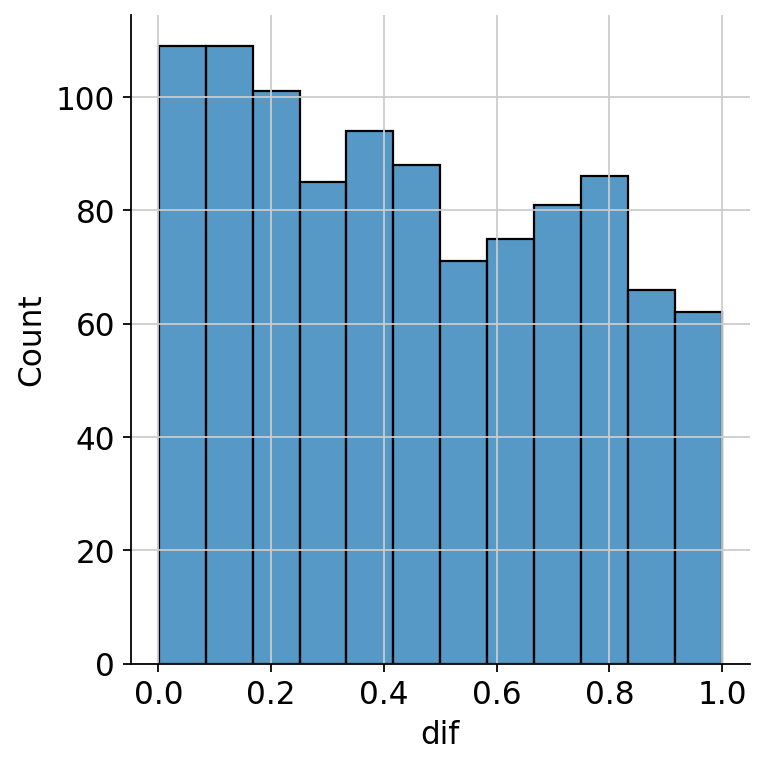

In [12]:
sns.displot(df[df.prediction == 'doublet'], x = 'dif')

-----
**Identificación de dobletes**
- Filtra las células que han sido clasificadas como dobletes y cuya diferencia entre doblete y singlete es mayor que 1.

In [13]:
doublets = df[(df.prediction == 'doublet') & (df.dif > 0.8)] # cambio para filtrar las células >0.8
doublets

,doublet,singlet,prediction,dif
AGTGTCATCTTGAGAC,0.951582,0.048418,doublet,0.903163
AGTCTTTAGTCAAGCG,0.901031,0.098969,doublet,0.802063
ACTTTCATCATTCACT,0.939348,0.060652,doublet,0.878697
TGTATTCAGATCGGGT,0.933775,0.066225,doublet,0.867551
TGGCGCAGTCGCTTCT,0.934625,0.065375,doublet,0.869249
...,...,...,...,...
AACTTTCAGATGCCAG,0.959721,0.040279,doublet,0.919443
TAAACCGTCATATCGG,0.976110,0.023890,doublet,0.952220
TCCCGATAGGCGACAT,0.998553,0.001447,doublet,0.997106
TGCTGCTAGGCCCTTG,0.927087,0.072913,doublet,0.854174


-----
**Marcar dobletes en `adata`**
- Añade una columna llamada `'doublet'` a la tabla de observaciones de `adata` (`adata.obs`). La columna tiene un valor `True` si el índice de la célula está en la lista de dobletes.

In [14]:
adata.obs['doublet'] = adata.obs.index.isin(doublets.index)

In [15]:
adata.obs

,n_genes,_scvi_batch,_scvi_labels,doublet
CellID,,,,
CCGGGATAGCTAGTGG,821,0,0,False
GCAATCACAATGACCT,763,0,0,False
CGGACGTAGGGTGTGT,478,0,0,False
GTACGTACATGTCTCC,1373,0,0,False
TAGAGCTTCTGTGCAA,322,0,0,False
...,...,...,...,...
ACTATCTCAATAGCGG,396,0,0,False
CTGCTGTTCCTAGAAC,254,0,0,False
GCGCAACCACAACGTT,230,0,0,False


-----
**Limpieza y eliminación de columnas innecesarias**
- Elimina columnas internas relacionadas con SCVI que ya no son necesarias.

In [16]:
columns_to_drop = ['_scvi_batch', '_scvi_labels']

# Eliminar las columnas
adata.obs.drop(columns_to_drop, axis=1, inplace=True)

-----
**Filtrado de dobletes**
- Filtra las células para mantener solo aquellas que no han sido marcadas como dobletes (`~adata.obs.doublet`).

In [17]:
adata = adata[~adata.obs.doublet]

In [18]:
adata.obs

,n_genes,doublet
CellID,,
CCGGGATAGCTAGTGG,821,False
GCAATCACAATGACCT,763,False
CGGACGTAGGGTGTGT,478,False
GTACGTACATGTCTCC,1373,False
TAGAGCTTCTGTGCAA,322,False
...,...,...
ACTATCTCAATAGCGG,396,False
CTGCTGTTCCTAGAAC,254,False
GCGCAACCACAACGTT,230,False


### <span style="color:navy">2.3 Creación de archivos h5ad</span>
**Guardar los datos filtrados**
- Guarda el objeto `adata` filtrado en un archivo `.h5ad` llamado `doublet_remov.h5ad`.

In [19]:
adata.write_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/doublet_remov.h5ad')

------------
# <span style="color:dodgerblue">3. Pre‐processing and visualization</span>

**<span style="color:steelblue">i) Preprocesamiento y visualización</span>**

Los datos crudos obtenidos de las máquinas de secuenciación se transforman en matrices de recuento molecular (matrices de recuento) o matrices de lectura, de acuerdo con la utilización de identificadores moleculares únicos (UMI) en la construcción de la biblioteca de células individuales. En este caso, herramientas como Cell Ranger, indrops, SEQC y zUMIs realizan el control de calidad de las lecturas (QC), asignan lecturas a sus códigos de barras celulares y al ARN mensajero correspondiente (demultiplexación), alinean al genoma y cuantifican los datos. Las matrices resultantes tienen como dimensiones el número de códigos de barras por número de transcripciones. En este contexto, el término “código de barras” reemplaza a “célula”, ya que no siempre las lecturas asignadas a un código de barras corresponden a la misma célula. Un código de barras podría llegar a etiquetar múltiples células (doblete) o ninguna célula (gotas vacías).

**<span style="color:steelblue">Pasos clave en un flujo de trabajo experimental de scRNA-seq</span>**

La generación de datos de células individuales de una muestra biológica implica varias etapas, incluyendo la disociación de células individuales, aislamiento, construcción de bibliotecas y secuenciación. 

1. **Disociación unicelular**: Se obtiene una suspensión de células individuales digiriendo el tejido biológico.
   
2. **Aislamiento de células**: Las células individuales se aíslan mediante técnicas basadas en placas, que capturan células en pocillos, o métodos de gotas, donde cada célula es encapsulada en una gota microfluídica. Estos métodos pueden producir errores, como dobletes (captura de múltiples células), células no viables, o pocillos/gotas vacíos.

3. **Construcción de bibliotecas**: En cada pocillo o gota, el ARN mensajero se etiqueta con un código de barras específico y, en muchos protocolos, también con un UMI. Luego, el ADN complementario (ADNc) resultante se amplifica para aumentar su detectabilidad.

4. **Secuenciación**: Las bibliotecas de ADNc, etiquetadas con códigos de barras y, en algunos protocolos, con UMI, se agrupan para la secuenciación. Estos datos de lectura pasan por control de calidad, demultiplexación y alineación en los canales de procesamiento. Para protocolos con UMI, se genera una matriz de recuento que contabiliza las moléculas de ARN capturadas.

Si bien los datos de lectura y de recuento presentan distintos niveles de ruido, el procesamiento en una secuencia de análisis típico es similar. 

------

Bondoc, A., Glaser, K., Jin, K., Lake, C., Cairo, S., Geller, J., Tiao, G., & Aronow, B. (2021). Identification of distinct tumor cell populations and key genetic mechanisms through single cell sequencing in hepatoblastoma. Communications biology, 4(1), 1049.[ https://doi.org/10.1038/s42003-021-02562-8 ]

----------

De acuerdo con el artículo, se realizó un análisis de secuenciación de ácido ribonucléico de células indiciduales (scRNAseq) de tumor humano de hepatoblastoma (HB); específicamente hígado de fondo y xenoinjerto derivado del paciente (PDX).

El tumor PDX se comparó con el hígado de fondo y el tumor HB primario y se evaluó mediante secuenciación de ARN de una sola célula (scRNAseq). Se recolectaron 26.886 células en 3 muestras después del preprocesamiento y el control de calidad.

------------
### <span style="color:navy">3.0 Configuración del entorno y datos</span>

In [102]:
#Para descargas
import gdown, os, gzip, shutil

# Gestión básica de datos y representación gráfica
import pandas as pd
import numpy as np
from scipy import sparse
import matplotlib.pyplot as plt
import os

# Fundamentos de Scanpy
import anndata as ad
import scanpy as sc
import seaborn as sb

# sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(figsize=(6, 6))
import scvi

## <span style="color:navy">3.1 Quality cotrol</span>
--------------------
**<span style="color:steelblue">ii) Control de calidad</span>**

El control de calidad se basa en:
   - Profundidad de recuento (cantidad de lecturas por código de barras).
   - Número de genes detectados.
   - Fracción de lecturas mitocondriales (indicador de células dañadas o moribundas).

**Identificación de Células Atípicas**:
   - *Células muertas o dañadas*: Pocos genes, baja profundidad de recuento, alta fracción de lecturas mitocondriales.
   - *Dobletes*: Alto número de genes y profundidad de recuento.
   - Herramientas como DoubletDecon, Scrublet y Doublet Finder ayudan a detectar dobletes.

**Umbrales Flexibles**: Las covariables deben evaluarse en conjunto para evitar excluir células viables. Es preferible comenzar con umbrales permisivos e ir ajustándolos.

**Filtrado de Genes**: Filtra genes poco expresados para reducir ruido, con umbrales ajustados según el tamaño de grupo de interés.

**ARN Ambiental**: Corrige la contaminación de ARN ambiental, especialmente en datos basados en gotas, usando herramientas como SoupX.

**Iteración y Ajustes**: La calidad de los datos debe evaluarse en función del análisis posterior. Reajusta los umbrales si la agrupación celular no es clara, especialmente en conjuntos de datos heterogéneos o de baja calidad. 

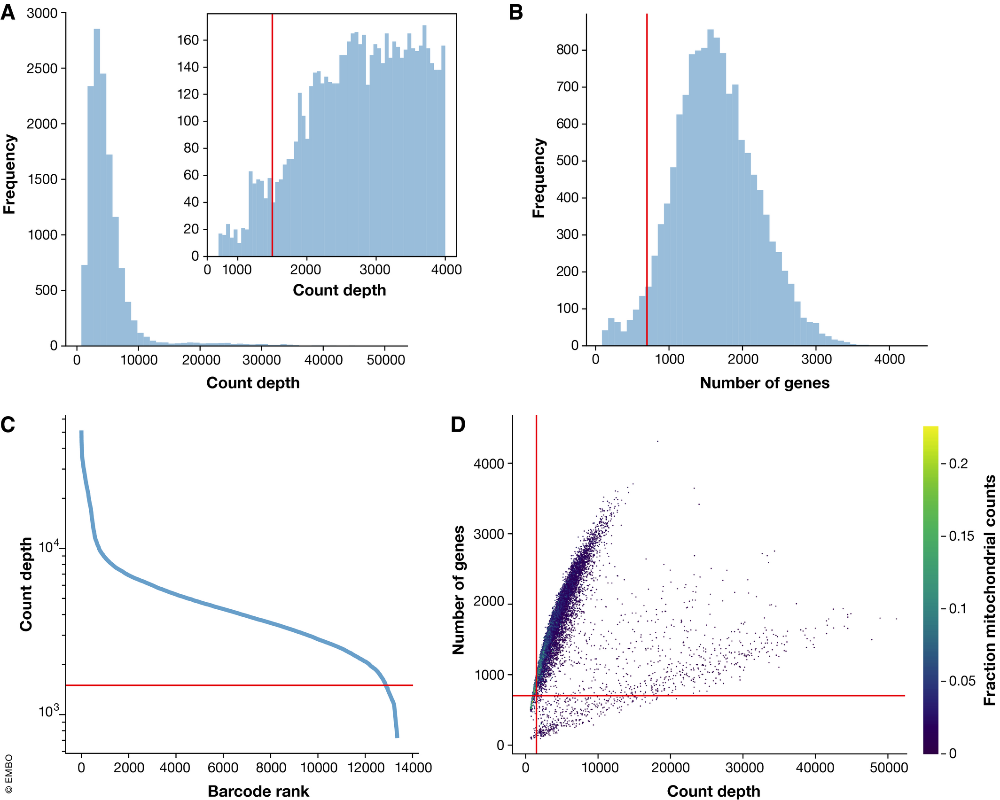

**Gráficos de métricas de control de calidad con decisiones de filtrado para un conjunto de datos** [Malte, D. L. & Fabián, J. Th. (2019) *Current best practices in single‐cell RNA‐seq analysis: a tutorial* Mol Syst Biol, 15: e8746 https://doi.org/10.15252/msb.20188746 ]

### <span style="color:navy">Preprocesamiento básico</span>
-----------
1. Eliminación de células con alto contenido mitocondrial.\
   Niveles elevados de ARN mitocondrial pueden indicar células estresadas o moribundas. Para ello, se establece un umbral máximo para la expresión de genes mitocondriales (valor máximo: 20%)

In [103]:
adata = sc.read_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/doublet_remov.h5ad')

In [104]:
# Crea una nueva columna 'mt' en la variable que contiene los genes, 
# indica cuáles genes pertenecen al ADN mitocondrial
adata.var['mt'] = adata.var.index.str.startswith('MT-')

In [105]:
adata.var # Muestra las variables del objeto 'adata', que incluye información sobre los genes

,gene_ids,n_cells,mt
AL669831.3,ENSG00000230021.9,161,False
MTND1P23,ENSG00000225972.1,2238,False
MTND2P28,ENSG00000225630.1,1776,False
MTCO1P12,ENSG00000237973.1,4217,False
MIR6723,ENSG00000278791.1,33,False
...,...,...,...
AL592183.1,ENSG00000273748.1,87,False
AC240274.1,ENSG00000271254.6,15,False
U1-6,ENSG00000275405.1,10,False
AC233755.1,ENSG00000275063.1,12,False


------------
a) **pp.calculate_qc_metrics**: cálculo de métricas de control de calidad.\
parámetros utilizados:\
`sc.pp.calculate_qc_metrics(adata`[Matriz de datos anotada], `qc_vars`[Tipo de cosa que son las variables, aquí son genes mitocondriales], `percent_top`[Lista de rangos de la porción acumulada de expresión como un porcentaje, aquí no se calculan], `log1p`[Transformadas], `inplace`[Para colocar métricas calculadas])

In [106]:
# Calcula métricas de control de calidad (QC), como el porcentaje de genes mitocondriales
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [107]:
# Ordena las variables (genes) de acuerdo al número de células en las que están presentes
adata.var.sort_values('n_cells_by_counts')

,gene_ids,n_cells,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts
AL138762.1,ENSG00000272572.1,10,False,10,0.001977,99.802332,10.0
RPL18AP16,ENSG00000237793.3,10,False,10,0.001977,99.802332,10.0
C1orf167,ENSG00000215910.7,10,False,10,0.001977,99.802332,10.0
P2RY2,ENSG00000175591.11,10,False,10,0.001977,99.802332,10.0
U91328.2,ENSG00000272462.2,10,False,10,0.001977,99.802332,10.0
...,...,...,...,...,...,...,...
MT-CO2,ENSG00000198712.1,5058,True,5058,162.227509,0.019767,820709.0
MT-CO3,ENSG00000198938.2,5058,True,5058,197.932205,0.019767,1001339.0
MT-RNR2,ENSG00000210082.2,5058,True,5058,114.115044,0.019767,577308.0
MT-CYB,ENSG00000198727.2,5059,True,5059,94.078476,0.000000,475943.0


------------------
2. **Filtrado de células con bajo recuento de genes**\
Aquellas que expresan una menor cantidad de genes únicos pueden ser poco informativas o pueden mostrar un error técnico.\
-> Aplicamos un umbral mínimo para excluir las células de baja calidad.

a) **sc.pp.filter_genes**: filtra genes según sea el número de células o recuentos.

`sc.pp.filter_genes(adata`[Matriz de datos anotada de forma n_obs× n_vars, donde las filas corresponden a las células y las columnas a los genes], `min_cells`[Número mínimo de células expresadas necesarias para que un gen pase el filtrado]`=3)`

In [108]:
# Filtra los genes que están presentes en menos de 3 células
sc.pp.filter_genes(adata, min_cells=3)

In [109]:
# Ordena nuevamente las variables para ver los genes después del filtrado
adata.var.sort_values('n_cells_by_counts')

,gene_ids,n_cells,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts
AL138762.1,ENSG00000272572.1,10,False,10,0.001977,99.802332,10.0
RPL18AP16,ENSG00000237793.3,10,False,10,0.001977,99.802332,10.0
C1orf167,ENSG00000215910.7,10,False,10,0.001977,99.802332,10.0
P2RY2,ENSG00000175591.11,10,False,10,0.001977,99.802332,10.0
U91328.2,ENSG00000272462.2,10,False,10,0.001977,99.802332,10.0
...,...,...,...,...,...,...,...
MT-CO2,ENSG00000198712.1,5058,True,5058,162.227509,0.019767,820709.0
MT-CO3,ENSG00000198938.2,5058,True,5058,197.932205,0.019767,1001339.0
MT-RNR2,ENSG00000210082.2,5058,True,5058,114.115044,0.019767,577308.0
MT-CYB,ENSG00000198727.2,5059,True,5059,94.078476,0.000000,475943.0


---------
b) **sc.pl.violin**: Trama de violín.\
`sc.pl.violin(adata`[Matriz de datos anotada], ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'], 
             `jitter`[Agrega fluctuación al diagrama de bandas (solo cuando el diagrama de bandas es Verdadero)]`=0.4, multi_panel`[Muestra teclas en varios paneles]`=True)`

- “n_cells_by_counts”: Número de celdas en las que se mide esta expresión.
- “total_counts”: Suma de recuentos de un gen.
- “pct_counts_mt”: Proporción del recuento total de mitocondrias de una sola célula.

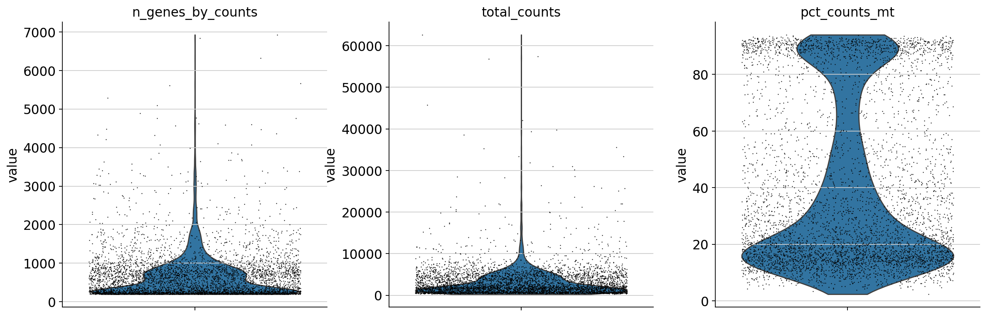

In [110]:
# Crea gráficos de violín para observar la distribución de métricas como el número de genes, el conteo total, 
# y el porcentaje de genes mitocondriales (indicador de calidad de la célula)
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'], 
             jitter=0.4, multi_panel=True)

---------
3. **Identificación y evalucación de células atípicas con expresión génica inusualmente alta o baja, así como otras características extremas**: Estas células atípicas pueden ser resultado de problemas técnicos o representar tipos de células poco comunes.

-> Uso de métodos estadísticos para determinar su inclusión o eliminación en el análisis.

a) **np.quantile**: Calcula el cuartil q-ésimo de los datos a lo largo del eje especificado.

`np.quantile(adata.obs.n_genes_by_counts.values, .98)`

In [111]:
# Calcula el límite superior del número de genes por célula (percentil 98)
upper_lim_genes = np.quantile(adata.obs.n_genes_by_counts.values, .98)
# Muestra el valor calculado del límite superior de genes por célula
upper_lim_genes

2536.0

In [112]:
# Filtra las células que tienen un número de genes por debajo del límite superior calculado
adata = adata[adata.obs.n_genes_by_counts < upper_lim_genes]

In [113]:
# Calcula el límite superior de los conteos totales por célula (percentil 98)
upper_lim_counts = np.quantile(adata.obs.total_counts.values, .98)
# Muestra el valor calculado del límite superior de conteos totales por célula
upper_lim_counts

8597.199999999997

In [114]:
# Filtra las células que tienen un total de conteos menor a  10,000
adata = adata[adata.obs.total_counts < 10000]

In [115]:
# Filtra las células que tienen menos del 20% de genes mitocondriales
adata = adata[adata.obs.pct_counts_mt < 20]

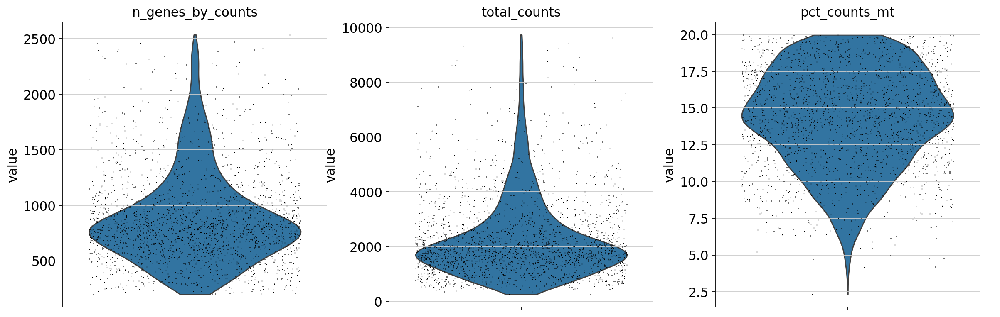

In [116]:
# Crea gráficos de violín nuevamente después del filtrado para comparar las métricas
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'], 
             jitter=0.4, multi_panel=True)

In [117]:
# Muestra información actualizada del objeto 'adata' después del filtrado
adata

View of AnnData object with n_obs × n_vars = 1914 × 16096
    obs: 'n_genes', 'doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: '_scvi_manager_uuid', '_scvi_uuid'

-------
## <span style="color:navy">3.2 Normalization</span>

**<span style="color:steelblue">iii) Normalización</span>**

**Objetivo de la Normalización**: Corregir variaciones en la profundidad de recuento entre células, que pueden deberse a diferencias técnicas en la captura y secuenciación de moléculas de ARNm. 

**Métodos de Normalización Comunes**:
   - **CPM (Counts per Million)**: Escala los recuentos según la profundidad de recuento total de cada célula. Funciona mejor cuando se asume un número inicial igual de moléculas de ARNm entre células.
   - **Submuestreo**: Limita el recuento total por célula, representando mejor profundidades de recuento similares pero con posibles aumentos de abandono técnico.
   - **Scran**: Calcula factores de tamaño a partir de una agrupación de células, permitiendo más heterogeneidad celular y superando otros métodos en corrección por lotes y análisis diferencial.
   - **Modelos no lineales**: Por ejemplo, ajustes de modelos binomiales negativos para casos con efectos complejos, especialmente útiles para datos basados en placas que presentan efectos de lote.

**Escalado de Genes**: Normalizar genes (media 0 y varianza unitaria) mejora la comparabilidad, pero no hay consenso sobre si debe aplicarse en todos los casos. Muchos optan por no escalar para conservar la información sobre la magnitud de expresión.

**Transformación Logarítmica**: Aplicar log(x+1) tiene tres efectos importantes:
   - Facilita la interpretación de cambios en la expresión.
   - Reduce la relación media-varianza en los datos.
   - Disminuye la asimetría de los datos, acercándolos a una distribución más adecuada para métodos de análisis posteriores.

**<span style="color:indianred">Recomendaciones Generales:</span>** 
   - Usar **Scran** para datos que no sean de longitud completa, o **scone** para evaluar múltiples métodos en datos basados en placas.
   - Para datos de longitud completa, utilizar métodos de normalización que consideren la longitud del gen.
   - La transformación log(x+1) es útil para análisis posteriores, pero debe manejarse con precaución debido a posibles efectos de expresión diferencial espurios.

La normalización nos permite ajustar la variabilidad de los datos que surge de las diferencias en la profundidad de secuenciación, el tamaño de las células así como otros factores técnicos. 

-> Aquí se garantiza que las diferencias observadas entre las células se deban a la variación biológica y no a problemas técnicos.

La normalización de recuento total implica escalar los recuentos brutos de cada célula por los recuentos totales de esa célula, seguido de una transformación logarítmica para estabilizar los datos. El logaritmo desplazado resulta beneficioso para estabilizar la varianza para la posterior reducción de la dimensionalidad y la identificación de genes expresados de forma diferencial.

In [118]:
# Suma los valores de la matriz de expresión a lo largo de las células (para cada célula)
adata.X.sum(axis = 1)

matrix([[1939.],
        [1756.],
        [9627.],
        ...,
        [1711.],
        [1712.],
        [1057.]], dtype=float32)

-------
1. **Escalado por recuentos totales** :Aquí se ajustan los recuentos de cada célula para considerar las diferencias en la profundidad de secuenciación o en el continido total de ARN. Comunmente se escalan los recuentos por un factor constante, normalmente 10 000 ("recuentos por diez mil" o CPTT). 

-> Crea una línea de base común para todas las células.

a) **sc.pp.normalize_total**: Normaliza los recuentos por celda.

`sc.pp.normalize_total(adata`[Matriz de datos anotada como n_obs x n_vars donde las filas corresponden a las células y las columnas corresponden a los genes], `target_sum`[cada observación (celda) tiene un recuento total igual a la mediana de los recuentos totales de las observaciones (celdas) antes de la normalización]`=1e4)`

In [119]:
# Normaliza los datos de expresión para que el total por célula sea igual a 10,000
sc.pp.normalize_total(adata, target_sum=1e4) # normaliza cada celda a 10.000 UMI

/home/mcgonzalez/miniconda3/envs/servicio/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [120]:
# Verifica nuevamente la suma de la matriz de expresión para cada célula después de la normalización
adata.X.sum(axis = 1)

matrix([[10000.   ],
        [10000.   ],
        [10000.001],
        ...,
        [ 9999.999],
        [ 9999.999],
        [10000.   ]], dtype=float32)

--------
2. **Transformación logarítmica**

Scanpy aplica una transformación logarítmica a los recuentos escalados, la cual nos ayuda a estabilizar la varianza para que los datos sean menos sensibles a los valores extremos y de este modo pueda facilitar el análisis posterior.

In [121]:
# Aplica la transformación logarítmica a los datos (logaritmo natural)
sc.pp.log1p(adata)

In [122]:
# Verifica la suma de la matriz de expresión después de la transformación logarítmica
adata.X.sum(axis = 1)

matrix([[1758.7179],
        [1698.9922],
        [1376.9243],
        ...,
        [1594.5846],
        [1628.174 ],
        [1562.9828]], dtype=float32)

In [123]:
# Almacena una copia de los datos sin procesar en 'adata.raw' para futuras referencias
adata.raw = adata

**Corrección e integración de datos**

La normalización descrita anteriormente intenta eliminar los efectos del muestreo por recuento. No obstante, los datos normalizados aún pueden contener variabilidad no deseada. La corrección de datos apunta a otras covariables técnicas y biológicas, como los efectos de lote, abandono o ciclo celular. Estas covariables no siempre se corrigen. Sin embargo, la decisión de qué covariables considerar dependerá del análisis posterior.

--------
## <span style="color:navy">3.3 Clustering</span>

**Objetivo**: explorar la diversidad celular e identificar tipos o estados celulares únicos. 

Este agrupamiento nos permite categorizar las células en función de sus perfiles de expresión genética y nos da información sobre la composición de una muestra.

Los datos de células individuales suelen tener miles de genes, lo que los hace altamente dimensionales. Antes del agrupamiento, se usan técnicas de reducción de dimensionalidad PCA (Análisis de componentes principales) y UMAP (Aproximación y proyección de colector uniforme) para reducir los datos a un espacio de menor dimensión. En este caso, se utiliza un agrupamiento basado en gráficos, el cual organiza las células en grupos en función de su conectividad en una estructura gráfica. 

------
**<span style="color:steelblue">iv) Reducción de dimensionalidad</span>**

La reducción de dimensionalidad es un paso importante en el análisis de datos de scRNA-seq que permite simplificar las matrices de expresión celular, manteniendo su estructura biológica fundamental en un espacio de baja dimensión. Esto facilita tanto la **visualización** como el **resumen** de los datos, maximizando la información esencial y minimizando la complejidad.

**Objetivos de la Reducción de Dimensionalidad**
1. **Visualización**: Representar los datos en 2 o 3 dimensiones para facilitar su interpretación visual. Métodos como t-SNE y UMAP son comunes para este propósito, ya que permiten visualizar la estructura de los datos sin requerir interpretabilidad estricta.
  
2. **Resumen**: Capturar las principales fuentes de variabilidad en el conjunto de datos, identificando su dimensionalidad inherente para un análisis posterior. Técnicas como PCA y mapas de difusión son ejemplos de métodos de resumen que identifican los componentes clave sin reducir estrictamente a dos o tres dimensiones, permitiendo usar estos componentes para otros análisis, como la agrupación o la inferencia de trayectorias.

**Técnicas de Reducción de Dimensionalidad**

1. **Análisis de Componentes Principales (PCA)**: Un método lineal que maximiza la varianza en cada dimensión nueva, facilitando la interpretación y el procesamiento de datos al permitir una representación consistente de distancias en todas las regiones del espacio dimensional reducido. Aunque PCA no siempre captura bien las estructuras complejas de los datos en pocas dimensiones, es valioso como paso de preprocesamiento y para evaluar la calidad de la normalización y corrección de datos. También permite observar qué genes o covariables técnicas influyen en los componentes principales, proporcionando información útil para evaluar la calidad del preprocesamiento.

2. **Mapas de Difusión**: Un método no lineal que enfatiza transiciones graduales, ideal para analizar procesos continuos como la diferenciación celular. Cada componente de difusión puede resaltar la variabilidad en distintas subpoblaciones celulares, lo cual es útil para estudios en los que los estados celulares transitorios o continuos son relevantes.

**Consideraciones Prácticas**
- **Interpretabilidad vs. Captura de Estructura Compleja**: PCA es útil para interpretabilidad, especialmente si se necesita correlacionar componentes con variables biológicas o técnicas. Los métodos no lineales (como los mapas de difusión) pueden capturar mejor las estructuras complejas en los datos, pero sacrifican la interpretabilidad.
- **Selección de Componentes**: En el PCA, la selección de los componentes relevantes puede basarse en el criterio del “codo” o en pruebas de permutación como Jackstraw, que evalúa la significancia de cada componente.
  
**<span style="color:indianred">Recomendaciones Generales:</span>** 
- La visualización bidimensional (p. ej., con t-SNE o UMAP) debe emplearse exclusivamente para interpretación gráfica y no para resumen de datos, mientras que métodos como PCA o los mapas de difusión son más adecuados para análisis detallados, conservando la variabilidad esencial.
  
La combinación de estos métodos, con una selección adecuada de componentes y técnicas de preprocesamiento, ayuda a obtener una representación simplificada, pero informativa, de la heterogeneidad celular, facilitando el descubrimiento de subpoblaciones y el estudio de trayectorias celulares en datos de scRNA-seq.

--------

**Algoritmo de Leiden**: es un método de agrupamiento basado en gráficos conocido por su eficiencia, precisión y solidez. Se usa ampliamente en el análisis de células individuales debido a su capacidad para encontrar grupos bien definidos en conjuntos de datos complejos.

a) **sc.pp.highly_variable_genes**: Anota genes que son altamente variables.

`sc.pp.highly_variable_genes(adata`[Matriz de datos anotada por n_obs x n_var, donde las filas corresponden al número de células y las columnas correspondel al número de genes], `n_top_genes`[Número de genes altamente variables que se deben conservar] `= 2000)`

In [124]:
# Identificación de genes altamente variables
sc.pp.highly_variable_genes(adata, n_top_genes = 2000)

In [125]:
# Muestra la información sobre los genes, incluyendo cuáles son altamente variables
adata.var

,gene_ids,n_cells,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,highly_variable,means,dispersions,dispersions_norm
AL669831.3,ENSG00000230021.9,161,False,161,0.032220,96.817553,163.0,False,0.055741,1.663877,-0.459799
MTND1P23,ENSG00000225972.1,2238,False,2238,1.202412,55.762008,6083.0,False,0.796119,1.865766,-0.438819
MTND2P28,ENSG00000225630.1,1776,False,1776,0.669698,64.894248,3388.0,False,0.605950,1.875881,-0.260170
MTCO1P12,ENSG00000237973.1,4217,False,4217,9.242736,16.643605,46759.0,False,2.236209,1.951989,-0.838616
MIR6723,ENSG00000278791.1,33,False,33,0.006721,99.347697,34.0,False,0.014892,1.669176,-0.442172
...,...,...,...,...,...,...,...,...,...,...,...
AL592183.1,ENSG00000273748.1,87,False,87,0.018581,98.280293,94.0,False,0.128785,1.780487,-0.071831
AC240274.1,ENSG00000271254.6,15,False,15,0.002965,99.703499,15.0,False,0.022825,1.590582,-0.703659
U1-6,ENSG00000275405.1,10,False,10,0.002965,99.802332,15.0,False,0.005069,0.994890,-2.685566
AC233755.1,ENSG00000275063.1,12,False,12,0.007907,99.762799,40.0,False,0.016757,1.973342,0.569811


-----------
**<span style="color:steelblue">v) Visualización</span>**

Para fines de visualización, es una práctica estándar usar métodos de reducción de dimensionalidad no lineal.

**t-SNE y UMAP para Visualización**: t-SNE es común para visualización en scRNA-seq, capturando similitudes locales pero perdiendo estructura global. UMAP, por su velocidad y capacidad de escalar, es ideal para visualización exploratoria y ofrece una mejor representación topológica que t-SNE.
   
**SPRING y PAGA**: SPRING usa el algoritmo ForceAtlas2 para representar mejor la topología, y PAGA permite visualizar la estructura gruesa de los datos basada en clústeres, simplificando la interpretación de grandes conjuntos de datos.

**Recomendaciones**:
   - Seleccionar entre 1,000 y 5,000 genes altamente variables (HVGs) según la complejidad de los datos.
   - Ajustar el preprocesamiento antes de seleccionar HVGs, evitando métodos basados en medias y varianzas en datos normalizados.
   - Separar los métodos de reducción de dimensionalidad: UMAP para visualización exploratoria, PCA para resumen general y mapas de difusión para análisis de trayectorias.

**PAGA y UMAP juntos**: Esta combinación es útil para visualizar datos complejos y de gran tamaño, proporcionando una representación visual adecuada de su estructura.

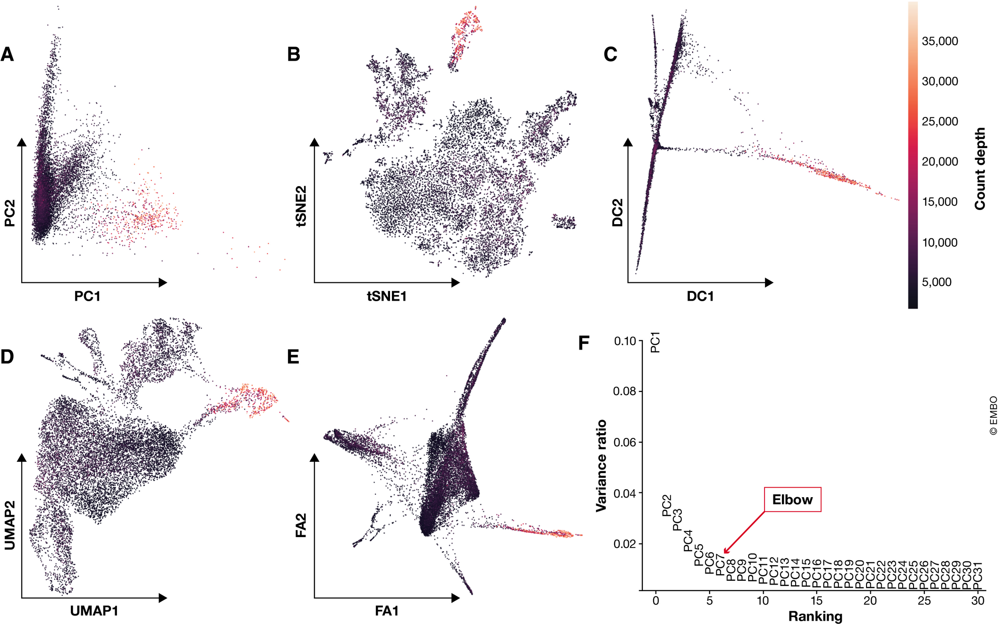

**Métodos de visualización comunes para datos de secuenciación de ARN sc** [Malte, D. L. & Fabián, J. Th. (2019) *Current best practices in single‐cell RNA‐seq analysis: a tutorial* Mol Syst Biol, 15: e8746 https://doi.org/10.15252/msb.20188746 ]

-------
b) **#sc.pl.highly_variable_genes(adata)**: Grafica dispersiones o varianza normalizada vs medias para los genes.

`sc.pl.highly_variable_genes(adata`[Muestra el resultado de "highly_variable_genes"])

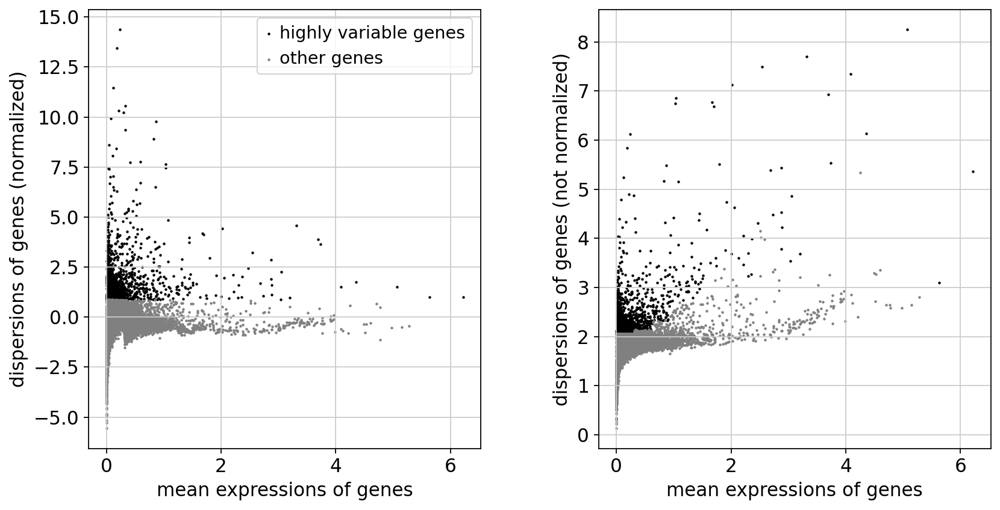

In [126]:
# Crea un gráfico de los genes altamente variables
sc.pl.highly_variable_genes(adata)

In [127]:
# Mantiene solo los genes altamente variables en los datos para los siguientes análisis
adata = adata[:, adata.var.highly_variable]

-------
c) **sc.pp.regress_out**: Eliminar (en su mayoría) las fuentes de variación no deseadas mediante regresión lineal simple.

`sc.pp.regress_out(adata`[La matriz de datos anotada], ['total_counts', 'pct_counts_mt'])

- “total_counts”: Suma de recuentos de un gen.
- “pct_counts_mt”: Proporción del recuento total de mitocondrias de una sola célula.

In [128]:
# Reajusta los efectos de covariables como el número total de conteos y el porcentaje de genes mitocondriales
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

/home/mcgonzalez/miniconda3/envs/servicio/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:668: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


------
d) **sc.pp.scale**: Escala datos a varianza unitaria y media cero.

`sc.pp.scale(adata`[Matriz de datos (anotada) de forma n_obs× n_vars. Las filas corresponden a las células y las columnas a los genes], `max_value`[Recortar (truncar) a este valor después de escalar]`=10)`

In [129]:
# Escala los datos para que cada gen tenga media 0 y varianza 1, con un valor máximo de 10
sc.pp.scale(adata, max_value=10)

------
e) **sc.tl.pca**: Análisis de Componentes Principales (PCA) que calcula coordenadas de PCA, cargas y descomposición de varianza.

`sc.tl.pca(adata`[Matriz de datos (anotada) de forma n_obs× n_vars donde las filas corresponden a las células y las columnas a los genes], `svd_solver`[Solucionador SVD a utilizar]`='arpack')`

In [130]:
# Realiza análisis de componentes principales (PCA) para reducir la dimensionalidad de los datos
sc.tl.pca(adata, svd_solver='arpack')

-------
f) **sc.pl.pca_variance_ratio**: Grafica la razón de varianza.

`sc.pl.pca_variance_ratio(adata`[Matriz de datos anotada], `log`[Trazar en escala logarítmica]`=True, n_pcs`[Número de PC a mostrar, por defecto es igual a 30 pero varía] `= 50)`

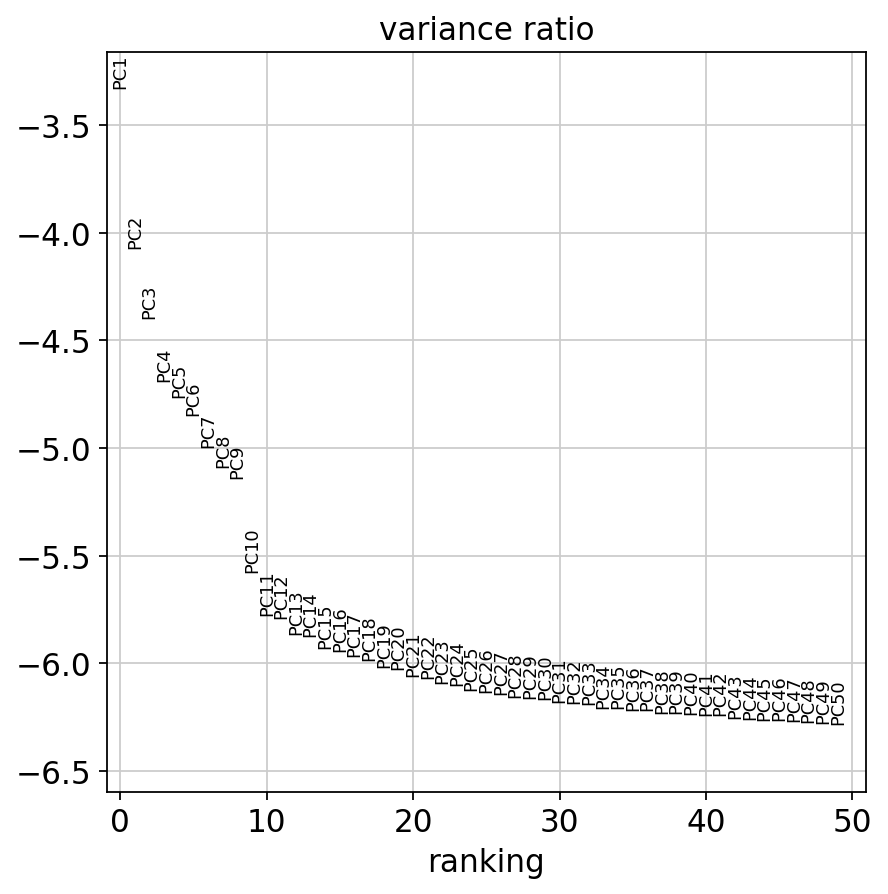

In [131]:
# Muestra un gráfico de la varianza explicada por los componentes principales (logaritmo)
sc.pl.pca_variance_ratio(adata, log=True, n_pcs = 50)

-------
g) **sc.pp.neighbors**: Calcula la matriz de distancia de los vecinos más cercanos y un gráfico de vecindad de observaciones.\
La eficiencia de búsqueda de vecinos de esto depende en gran medida de UMAP (Aproximación y proyección de colector uniforme) que también proporciona un método para estimar las conectividades de los puntos de datos: la conectividad de la variedad.

`sc.pp.neighbors(adata`[Matriz de datos anotada], `n_pcs`[Utiliza la cantidad de PC] `= 30)`

In [132]:
# Calcula la matriz de vecinos más cercanos para las células usando los primeros 30 componentes principales
sc.pp.neighbors(adata, n_pcs = 30)

---------
h) **sc.tl.umap**: Incrustra el gráfico de vecindad usando UMAP (Aproximación y proyección de colector uniforme) para visualizar datos de alta dimensión. Optimiza la incrustación de modo que refleje mejor la topología de los datos.

`sc.tl.umap(adata`[Matriz de datos anotada])

i) **sc.pl.umap**: Diagrama de dispersión en base UMAP (Aproximación y proyección de colector uniforme).

`sc.pl.umap(adata`[Matriz de datos anotada])

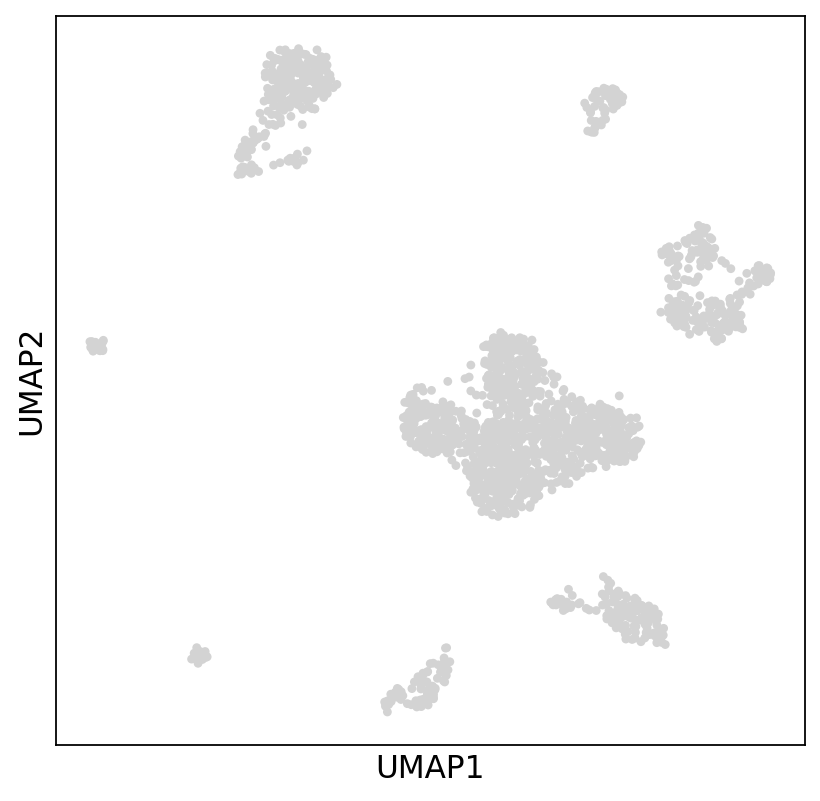

In [133]:
# Realiza una proyección de UMAP (técnica de reducción de dimensionalidad)
sc.tl.umap(adata) # UMAP: visualizar datos de alta dimensión
# Crea un gráfico de UMAP para visualizar las células en el espacio reducido
sc.pl.umap(adata)

--------
3. **Leiden**

Leiden comienza construyendo un "gráfico de vecinos", donde cada nodo representa una célula y los bordes representan conexiones entre células en función de su similitud (que a menudo se mide utilizando los k vecinos más cercanos u otras métricas de distancia). Luego, el algoritmo aplica un proceso llamado "detección de comunidad" para identificar grupos de células estrechamente relacionadas dentro del gráfico.

**Pasos clave**:

- **Particionado de nodos**: Leiden asigna células (nodos) a los grupos iniciales, lo que crea una partición del gráfico.
- **Refinamiento de nodos**: el algoritmo refina la partición evaluando la modularidad (una medida de la solidez de los clústeres) y moviendo los nodos para mejorar la modularidad.
- **Optimización de clústeres**: Leiden continúa refinando los clústeres hasta que no se puedan realizar más mejoras.
  
**Resultado final**: conjunto de clústeres que representan grupos distintos de células, que se pueden utilizar para análisis posteriores como visualización, expresión diferencial o anotación de tipo de célula.

-----
a) **sc.tl.leiden**: Agrupa células en subgrupos.

`sc.tl.leiden(adata`[La matriz de datos anotada], `resolution`[Un valor de parámetro que controla la tosquedad de la agrupación donde los valores más altos generan más agrupaciones] `= 1)`

In [134]:
# Realiza un clustering de las células utilizando el algoritmo Leiden con una resolución de 1
sc.tl.leiden(adata, resolution = 1) # Por defecto la resolución es 1

/tmp/ipykernel_1289644/1726027082.py:2: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution = 1) # Por defecto la resolución es 1


In [135]:
# Muestra las observaciones (células) con las etiquetas del clustering Leiden
adata.obs

,n_genes,doublet,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden
CellID,,,,,,,
CCGGGATAGCTAGTGG,821,False,818,1939.0,364.0,18.772564,1
GCAATCACAATGACCT,763,False,759,1756.0,325.0,18.507973,0
GTACGTACATGTCTCC,1373,False,1369,9627.0,570.0,5.920847,11
CAGCAGCGTGGCTCCA,1189,False,1185,3778.0,371.0,9.820010,4
ACTGATGAGACAAGCC,1584,False,1577,5032.0,878.0,17.448332,13
...,...,...,...,...,...,...,...
TTCGAAGTCCGTCATC,879,False,876,1724.0,233.0,13.515080,2
GGGATGAGTTAAAGAC,685,False,681,1322.0,197.0,14.901665,2
CTACCCATCTGTTGAG,704,False,703,1711.0,246.0,14.377557,6


------
i) **sc.pl.umap**: Diagrama de dispersión en base UMAP (Aproximación y proyección de colector uniforme).

`sc.pl.umap(adata`[Matriz de datos anotada], `color`[Claves para anotaciones de observaciones/células o variables/genes] `=['leiden'])`

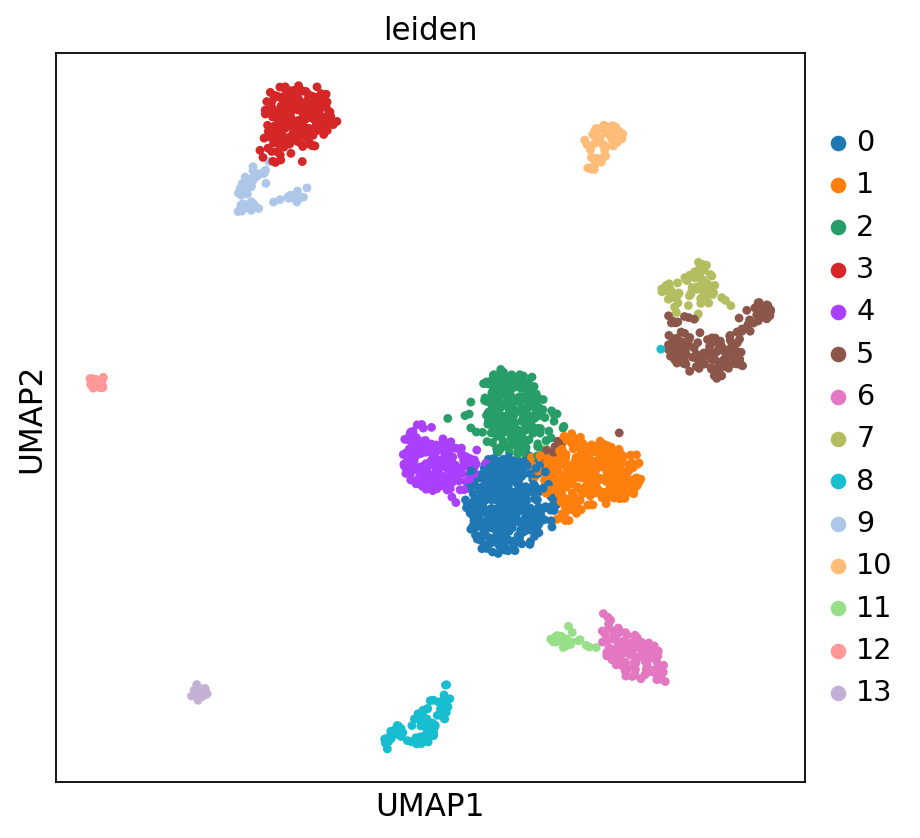

In [136]:
# Crea un gráfico UMAP coloreado por las etiquetas de los clusters Leiden
# Diagrama de dispersión en base UMAP.
sc.pl.umap(adata, color=['leiden'])

## <span style="color:navy">Creación de archivo h5ad</span>

In [137]:
adata.write_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/P1_QC.h5ad')

------
# <span style="color:dodgerblue">4. Identificación de la estructura celular</span>

## <span style="color:navy">4.1 Integración y corrección de efectos de lotes</span> 

La corrección de efectos de lote y la integración de datos son dos procesos importantes para asegurar la comparabilidad de datos de scRNA-seq entre distintos grupos de células y experimentos.

**Efectos de lote:**

Los efectos de lote pueden surgir cuando las células se procesan en diferentes entornos, como en diferentes chips, carriles de secuenciación, o momentos de recolección, lo cual puede introducir variabilidad en las mediciones del transcriptoma. La corrección de estos efectos, común en secuenciación de ARN en masa, ahora también es vital en scRNA-seq. ComBat, un método lineal para corrección de lotes, ha mostrado buenos resultados en datos de células individuales de complejidad baja a media, ya que ajusta los efectos de lote en la media y la varianza de los datos. Sin embargo, una solución ideal es anticipar estos efectos mediante un diseño experimental que reduzca el impacto de los lotes, por ejemplo, agrupando células en distintas condiciones o usando etiquetado celular.

**Integración de datos:**
La integración de datos se vuelve crucial cuando se combinan muestras de diferentes experimentos, laboratorios o condiciones. Métodos como CCA, MNN y Harmony permiten integrar datos considerando las diferencias en la composición celular entre conjuntos, algo que los métodos de corrección de lotes lineales no abordan de forma óptima. Sin embargo, estos métodos no lineales pueden sobrecorregir los datos en situaciones de efectos de lote simples, por lo que se requiere prudencia para evitar la pérdida de variabilidad biológica real.

**Recuperación de expresión:**
La imputación de datos o recuperación de expresión intenta compensar la pérdida de expresión que puede ocurrir por ruidos técnicos, especialmente en genes con valores cero por cuestiones de muestreo. Herramientas como MAGIC, DCA y scVI ayudan a estimar la expresión perdida, aunque pueden introducir correlaciones falsas. Se sugiere que este paso se utilice principalmente en visualizaciones y análisis exploratorios y no para inferencia concluyente, a menos que se cuente con validación experimental adicional.

**<span style="color:indianred">Recomendaciones Generales:</span>** 
- **Corrección de lotes**: ComBat es una opción sólida cuando los tipos de células y estados entre lotes son consistentes. 
- **Integración de datos**: Se recomiendan herramientas especializadas para evitar una sobrecorrección.
- **Recuperación de expresión**: Es mejor aplicarla solo para visualización, manteniendo un enfoque cauteloso en los análisis exploratorios y evitando depender de estos datos para hipótesis de investigación sin confirmación experimental.

En este caso, para eliminar estos artefactos técnicos tras la integración, utilizamos *scVI* (inferencia variacional de células individuales), una técnica de aprendizaje profundo diseñada para la integración de datos en estudios de células individuales. Este método se basa en un autocodificador variacional (VAE), que es una red neuronal que crea una representación de baja dimensionalidad de los datos de células individuales. *scVI* destaca por su capacidad para modelar relaciones complejas dentro de los datos, lo que lo hace especialmente efectivo en la integración de conjuntos con estructuras de lotes diversas o con alta heterogeneidad.

**¿Cómo funciona?** El modelo se entrena con el conjunto de datos combinado para aprender su estructura subyacente, lo que permite mapear los datos de alta dimensión en un "espacio latente" de menor dimensión. Esta representación latente captura patrones biológicos clave, mientras que reduce el ruido técnico, proporcionando una base común para integrar múltiples conjuntos de datos. Durante el entrenamiento, *scVI* distingue entre variabilidad biológica y técnica, corrigiendo los efectos de lote para asegurar que las diferencias observadas reflejen cambios biológicos reales. Una vez completada la integración, esta representación latente puede utilizarse en análisis posteriores como la agrupación, visualización (mediante UMAP o t-SNE) y estudios de expresión genética diferencial. El conjunto de datos integrado generado por *scVI* ofrece una visión cohesiva que permite obtener información valiosa sobre la complejidad biológica de las muestras.

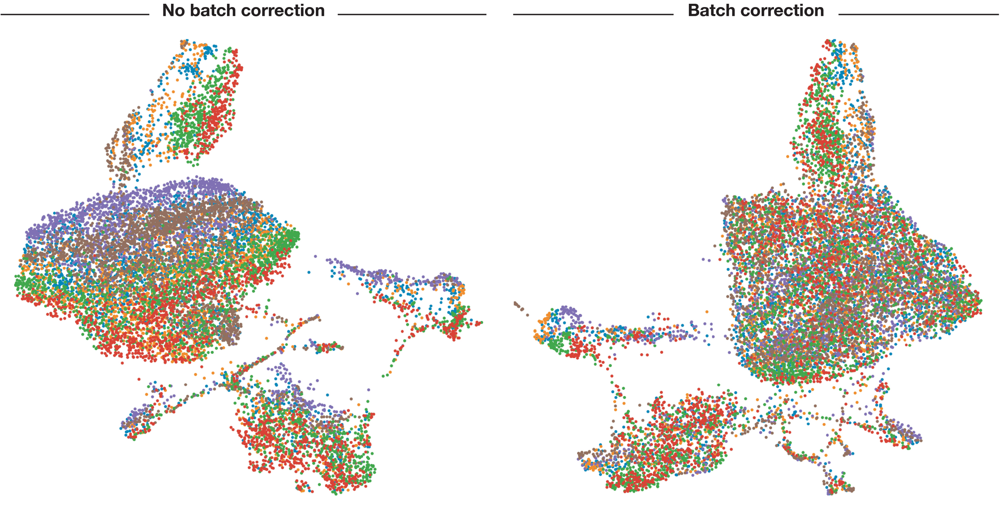

**Visualización de UMAP antes y después de la corrección por lotes** [Malte, D. L. & Fabián, J. Th. (2019) *Current best practices in single‐cell RNA‐seq analysis: a tutorial* Mol Syst Biol, 15: e8746 https://doi.org/10.15252/msb.20188746 ]

-----
### <span style="color:navy">4.0 Configuración del entorno y datos</span>
Este código realiza la integración y corrección de efectos de lotes en un conjunto de datos de secuenciación de célula única utilizando modelos variacionales de scVI y el método SOLO para la detección de dobletes. 

In [2]:
#For downloads
import gdown, os, gzip, shutil

# Basic data management and plotting
import pandas as pd
import numpy as np
from scipy import sparse
import matplotlib.pyplot as plt
import os

# Scanpy fundamentals
import anndata as ad
import scanpy as sc
import seaborn as sb

# sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(figsize=(6, 6))
import scvi
from scvi.external import SOLO

/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
%cd /home/mcgonzalez/Servicio_Social/Data/adata_saved

/home/mcgonzalez/Servicio_Social/Data/adata_saved


In [4]:
adata = sc.read_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/P1_QC.h5ad')

In [5]:
adata

AnnData object with n_obs × n_vars = 1914 × 2000
    obs: 'n_genes', 'doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'gene_ids', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

----
**Identificación de dobletes y preprocesamiento de datos**
- Esta función lee un archivo `h5ad` y filtra genes poco expresados.
- Selecciona los genes más variables utilizando el método `Seurat v3`.
- Configura y entrena el modelo SCVI para la detección de dobletes con SOLO.
- Predice dobletes y calcula la diferencia entre la probabilidad de ser doblete o singlete.
- Filtra las células marcadas como dobletes basadas en un umbral de diferencia.
- Vuelve a cargar el archivo `h5ad` y asigna el identificador de muestra extraído del nombre del archivo a una nueva columna `'Sample'`.
- Marca los dobletes en `adata` y los filtra del objeto.
- Filtra células con menos de 200 genes detectados.
- Añade una etiqueta para genes mitocondriales (`mt`) y calcula métricas de control de calidad.
- Filtra células con un número de genes mayor al percentil 98 y aquellas con más del 20% de contenido mitocondrial.

In [5]:
def pp(h5ad_path):
    adata = sc.read_h5ad(h5ad_path) 
    sc.pp.filter_genes(adata, min_cells=10)
    sc.pp.highly_variable_genes(adata, n_top_genes=2000, subset=True, flavor='seurat_v3')
    scvi.model.SCVI.setup_anndata(adata)
    vae = scvi.model.SCVI(adata)
    vae.train()
    solo = SOLO.from_scvi_model(vae)
    solo.train()
    df = solo.predict()
    df['prediction'] = solo.predict(soft=False)
    df['dif'] = df.doublet - df.singlet
    doublets = df[(df.prediction == 'doublet') & (df.dif > 1)]
    df = df.dropna()
    adata = sc.read_h5ad(h5ad_path)
    adata.obs['Sample'] = h5ad_path.split('_')[2]  
    adata.obs['doublet'] = adata.obs.index.isin(doublets.index)
    adata = adata[~adata.obs.doublet]
    sc.pp.filter_cells(adata, min_genes=200)
    adata.var['mt'] = adata.var_names.str.startswith('mt-')
    sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
    upper_lim = np.quantile(adata.obs.n_genes_by_counts.values, .98)
    adata = adata[adata.obs.n_genes_by_counts < upper_lim]
    adata = adata[adata.obs.pct_counts_mt < 20]
    df = df.dropna()  
    return adata

----
**Cargar y procesar múltiples archivos `h5ad`**
- Lee una lista de archivos `h5ad` y aplica la función `pp` a cada uno, almacenando los objetos `AnnData` en la lista `out`.

In [6]:
os.listdir('/home/mcgonzalez/Servicio_Social/Data/Inicial_h5ad')

['tumor_s5',
 '.ipynb_checkpoints',
 'tumor_s3',
 'control6',
 'tumor_s4',
 'control1',
 'tumor_s1',
 'tumor_s2',
 'control2',
 'control4',
 'control3',
 'control5',
 'control7']

-------
**Nota:** Para esta función es necesario instalar el paquete `scikit-misc` desde la terminar como: conda install -c conda-forge scikit-misc o pip install scikit-misc

`scikit-misc` es un paquete de Python que ofrece herramientas estadísticas avanzadas para el análisis de datos. Su nombre completo es *Scikit-Miscellaneous*, y contiene funciones que no están incluidas en bibliotecas estadísticas estándar como `scipy` o `statsmodels`.

Este paquete proporciona funciones estadísticas especializadas, como:

1. **Modelos Mixtos**: Permite el ajuste de modelos lineales mixtos, una clase de modelos estadísticos útiles cuando se tiene en cuenta la variabilidad entre grupos o sujetos.
2. **Estadísticas Avanzadas**: Ofrece funciones adicionales para análisis estadísticos, como estimaciones robustas y herramientas para modelos lineales.
3. **Filtros y Transformaciones de Señales**: incluye métodos para el procesamiento de señales y datos temporales.

-----
**<span style="color:indianred">Advertencia:</span>**  este paso tarda aproximadamente 5-6 horas en procesar.

In [7]:
out = []
for file in os.listdir('/home/mcgonzalez/Servicio_Social/Data/Inicial_h5ad/'):
    file_path = os.path.join('/home/mcgonzalez/Servicio_Social/Data/Inicial_h5ad/', file)
    if os.path.isfile(file_path):  # Verifica si es un archivo
        out.append(pp(file_path))

/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scvi/data/fields/_layer_field.py:115: UserWarning: Training will be faster when sparse matrix is formatted as CSR. It is safe to cast before model initialization.
  _verify_and_correct_data_format(adata, self.attr_name, self.attr_key)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, p

Epoch 400/400: 100%|█| 400/400 [5:26:36<00:00, 49.54s/it, v_num=1, train_loss_st

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [5:26:36<00:00, 48.99s/it, v_num=1, train_loss_st
INFO     Creating doublets, preparing SOLO model.                                                                  


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scvi/data/fields/_layer_field.py:115: UserWarning: Training will be faster when sparse matrix is formatted as CSR. It is safe to cast before model initialization.
  _verify_and_correct_data_format(adata, self.attr_name, self.attr_key)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, p

Epoch 184/400:  46%|▍| 184/400 [03:23<03:59,  1.11s/it, v_num=1, train_loss_step
Monitored metric validation_loss did not improve in the last 30 records. Best score: 0.262. Signaling Trainer to stop.


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:167: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as

Epoch 400/400: 100%|█| 400/400 [5:27:08<00:00, 49.08s/it, v_num=1, train_loss_st

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [5:27:08<00:00, 49.07s/it, v_num=1, train_loss_st
INFO     Creating doublets, preparing SOLO model.                                                                  


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scvi/data/fields/_layer_field.py:115: UserWarning: Training will be faster when sparse matrix is formatted as CSR. It is safe to cast before model initialization.
  _verify_and_correct_data_format(adata, self.attr_name, self.attr_key)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, p

Epoch 238/400:  60%|▌| 238/400 [04:26<03:01,  1.12s/it, v_num=1, train_loss_step
Monitored metric validation_loss did not improve in the last 30 records. Best score: 0.274. Signaling Trainer to stop.


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:167: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as

Epoch 400/400: 100%|█| 400/400 [4:42:38<00:00, 42.29s/it, v_num=1, train_loss_st

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [4:42:38<00:00, 42.40s/it, v_num=1, train_loss_st
INFO     Creating doublets, preparing SOLO model.                                                                  


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scvi/data/fields/_layer_field.py:115: UserWarning: Training will be faster when sparse matrix is formatted as CSR. It is safe to cast before model initialization.
  _verify_and_correct_data_format(adata, self.attr_name, self.attr_key)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, p

Epoch 143/400:  36%|▎| 143/400 [02:18<04:08,  1.04it/s, v_num=1, train_loss_step
Monitored metric validation_loss did not improve in the last 30 records. Best score: 0.339. Signaling Trainer to stop.


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:167: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as

Epoch 400/400: 100%|█| 400/400 [3:25:44<00:00, 30.70s/it, v_num=1, train_loss_st

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [3:25:44<00:00, 30.86s/it, v_num=1, train_loss_st
INFO     Creating doublets, preparing SOLO model.                                                                  


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scvi/data/fields/_layer_field.py:115: UserWarning: Training will be faster when sparse matrix is formatted as CSR. It is safe to cast before model initialization.
  _verify_and_correct_data_format(adata, self.attr_name, self.attr_key)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, p

Epoch 168/400:  42%|▍| 168/400 [01:57<02:42,  1.43it/s, v_num=1, train_loss_step
Monitored metric validation_loss did not improve in the last 30 records. Best score: 0.240. Signaling Trainer to stop.


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:167: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as

Epoch 400/400: 100%|█| 400/400 [2:07:06<00:00, 18.90s/it, v_num=1, train_loss_st

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [2:07:06<00:00, 19.07s/it, v_num=1, train_loss_st
INFO     Creating doublets, preparing SOLO model.                                                                  


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which ma

Epoch 284/400:  71%|▋| 284/400 [02:04<00:50,  2.29it/s, v_num=1, train_loss_step
Monitored metric validation_loss did not improve in the last 30 records. Best score: 0.297. Signaling Trainer to stop.


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:167: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as

Epoch 400/400: 100%|█| 400/400 [3:23:40<00:00, 30.67s/it, v_num=1, train_loss_st

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [3:23:40<00:00, 30.55s/it, v_num=1, train_loss_st
INFO     Creating doublets, preparing SOLO model.                                                                  


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scvi/data/fields/_layer_field.py:115: UserWarning: Training will be faster when sparse matrix is formatted as CSR. It is safe to cast before model initialization.
  _verify_and_correct_data_format(adata, self.attr_name, self.attr_key)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, p

Epoch 230/400:  57%|▌| 230/400 [02:42<01:59,  1.42it/s, v_num=1, train_loss_step
Monitored metric validation_loss did not improve in the last 30 records. Best score: 0.208. Signaling Trainer to stop.


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:167: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as

Epoch 400/400: 100%|█| 400/400 [8:05:39<00:00, 72.64s/it, v_num=1, train_loss_st

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [8:05:39<00:00, 72.85s/it, v_num=1, train_loss_st
INFO     Creating doublets, preparing SOLO model.                                                                  


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scvi/data/fields/_layer_field.py:115: UserWarning: Training will be faster when sparse matrix is formatted as CSR. It is safe to cast before model initialization.
  _verify_and_correct_data_format(adata, self.attr_name, self.attr_key)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, p

Epoch 216/400:  54%|▌| 216/400 [05:57<05:04,  1.65s/it, v_num=1, train_loss_step
Monitored metric validation_loss did not improve in the last 30 records. Best score: 0.272. Signaling Trainer to stop.


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:167: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as

Epoch 400/400: 100%|█| 400/400 [3:13:37<00:00, 29.38s/it, v_num=1, train_loss_st

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [3:13:37<00:00, 29.04s/it, v_num=1, train_loss_st
INFO     Creating doublets, preparing SOLO model.                                                                  


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which ma

Epoch 275/400:  69%|▋| 275/400 [03:05<01:24,  1.48it/s, v_num=1, train_loss_step
Monitored metric validation_loss did not improve in the last 30 records. Best score: 0.323. Signaling Trainer to stop.


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:167: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as

Epoch 400/400: 100%|█| 400/400 [1:17:40<00:00, 11.58s/it, v_num=1, train_loss_st

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [1:17:40<00:00, 11.65s/it, v_num=1, train_loss_st
INFO     Creating doublets, preparing SOLO model.                                                                  


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which ma

Epoch 315/400:  79%|▊| 315/400 [01:27<00:23,  3.60it/s, v_num=1, train_loss_step
Monitored metric validation_loss did not improve in the last 30 records. Best score: 0.288. Signaling Trainer to stop.


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  

Epoch 400/400: 100%|█| 400/400 [1:10:33<00:00, 10.58s/it, v_num=1, train_loss_st

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [1:10:33<00:00, 10.58s/it, v_num=1, train_loss_st
INFO     Creating doublets, preparing SOLO model.                                                                  


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which ma

Epoch 263/400:  66%|▋| 263/400 [01:04<00:33,  4.06it/s, v_num=1, train_loss_step
Monitored metric validation_loss did not improve in the last 30 records. Best score: 0.345. Signaling Trainer to stop.


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:167: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as

Epoch 400/400: 100%|█| 400/400 [3:24:33<00:00, 30.82s/it, v_num=1, train_loss_st

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [3:24:33<00:00, 30.68s/it, v_num=1, train_loss_st
INFO     Creating doublets, preparing SOLO model.                                                                  


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which ma

Epoch 146/400:  36%|▎| 146/400 [01:49<03:09,  1.34it/s, v_num=1, train_loss_step
Monitored metric validation_loss did not improve in the last 30 records. Best score: 0.216. Signaling Trainer to stop.


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:167: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as

Epoch 400/400: 100%|█| 400/400 [3:36:08<00:00, 32.77s/it, v_num=1, train_loss_st

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [3:36:08<00:00, 32.42s/it, v_num=1, train_loss_st
INFO     Creating doublets, preparing SOLO model.                                                                  


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scvi/data/fields/_layer_field.py:115: UserWarning: Training will be faster when sparse matrix is formatted as CSR. It is safe to cast before model initialization.
  _verify_and_correct_data_format(adata, self.attr_name, self.attr_key)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, p

Epoch 281/400:  70%|▋| 281/400 [03:29<01:28,  1.34it/s, v_num=1, train_loss_step
Monitored metric validation_loss did not improve in the last 30 records. Best score: 0.256. Signaling Trainer to stop.


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/torch/utils/_contextlib.py:116: UserWarning: Prior to scvi-tools 1.1.3, `SOLO.predict` with `soft=True` (the default option) returned logits instead of probabilities. This behavior has since been corrected to return probabiltiies. The previous behavior can be replicated by passing in `return_logits=True`.
  return func(*args, **kwargs)
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:167: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as

El error `IsADirectoryError: [Errno 21]` indica que el código intentó abrir un directorio en lugar de un archivo. Esto ocurre cuando `os.listdir` incluye subdirectorios (como `.ipynb_checkpoints` en este caso).

Aquí modificamos el bucle `for` para asegurarnos de que solo se procesen archivos y se excluyan directorios. La función `os.path.isfile` verifica si la ruta es un archivo. En general:

- `os.path.join` construye la ruta completa para cada archivo.
- `os.path.isfile` asegura que solo se procesen archivos, ignorando directorios como `.ipynb_checkpoints` 

**Concatenación e integración de objetos `AnnData`**
- Asegura que los nombres de observaciones y variables sean únicos en cada objeto `AnnData` antes de concatenarlos.
- Concatenación de los objetos de `out` en un único objeto `adata`

In [8]:
# Remove duplicate labels
for ad in out:
    ad.obs_names_make_unique()
    ad.var_names_make_unique()

# Concatenate Anndata object
adata = sc.concat(out)

# Make sure index and labels are unique
adata.obs_names_make_unique()
adata.var_names_make_unique()

/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/anndata/utils.py:261: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['GTCATTTCATTAGGCT-1']
  warnings.warn(


In [9]:
adata

AnnData object with n_obs × n_vars = 105197 × 11762
    obs: 'n_genes', 'Sample', 'doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'

----
**Preprocesamiento adicional y normalización**
- Filtra genes presentes en menos de 10 células y convierte la matriz de datos en una matriz dispersa para optimizar la memoria.
- Guarda el archivo combinado `adata` como `P2_combined.h5ad`.

In [10]:
sc.pp.filter_genes(adata, min_cells = 10)

In [11]:
adata.X

<Compressed Sparse Row sparse matrix of dtype 'float32'
	with 187495847 stored elements and shape (105197, 11762)>

In [12]:
from scipy.sparse import csr_matrix

In [13]:
adata.X = csr_matrix(adata.X)
adata.X

<Compressed Sparse Row sparse matrix of dtype 'float32'
	with 187495847 stored elements and shape (105197, 11762)>

In [14]:
adata

AnnData object with n_obs × n_vars = 105197 × 11762
    obs: 'n_genes', 'Sample', 'doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells'

In [15]:
adata.obs['Sample']

AAACCCAAGACCGCCT-1       h5ad/tumor
AAACCCAAGAGGCGGA-1       h5ad/tumor
AAACCCAAGCAGCCTC-1       h5ad/tumor
AAACCCAAGCCGTTAT-1       h5ad/tumor
AAACCCAAGGACGGAG-1       h5ad/tumor
                          ...      
TTTGTTGGTCCTTTGC-1    h5ad/control7
TTTGTTGGTCTCGGGT-1    h5ad/control7
TTTGTTGGTGCCTGCA-1    h5ad/control7
TTTGTTGTCAGAACCT-1    h5ad/control7
TTTGTTGTCCGATCTC-1    h5ad/control7
Name: Sample, Length: 105197, dtype: object

In [16]:
adata.write_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/P2_combined.h5ad')

----
**Configuración y entrenamiento de SCVI para integración**
- Configura los datos para SCVI incluyendo las covariables categóricas (`Sample`) y continuas (`pct_counts_mt`, `total_counts`).
- Entrena el modelo SCVI para aprender una representación latente corregida por lotes.

In [17]:
adata = sc.read_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/P2_combined.h5ad')
adata

AnnData object with n_obs × n_vars = 105197 × 11762
    obs: 'n_genes', 'Sample', 'doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells'

----
**Proyección y visualización de la estructura celular**
- Extrae la representación latente corregida (`X_scVI`) y la guarda en `obsm`.
- Normaliza la matriz de expresión utilizando el modelo SCVI.
- Calcula la vecindad y genera una visualización UMAP, seguida de la identificación de clústeres con Leiden.

In [6]:
adata = sc.read_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/P2_combined.h5ad')

In [7]:
adata

AnnData object with n_obs × n_vars = 105197 × 11762
    obs: 'n_genes', 'Sample', 'doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells'

In [8]:
adata.obs.groupby('Sample').count()

/tmp/ipykernel_2316688/2340059915.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs.groupby('Sample').count()


,n_genes,doublet,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
Sample,,,,,,
h5ad/control1,4956,4956,4956,4956,4956,4956
h5ad/control2,7611,7611,7611,7611,7611,7611
h5ad/control3,2704,2704,2704,2704,2704,2704
h5ad/control4,3059,3059,3059,3059,3059,3059
h5ad/control5,8015,8015,8015,8015,8015,8015
h5ad/control6,10973,10973,10973,10973,10973,10973
h5ad/control7,8369,8369,8369,8369,8369,8369
h5ad/tumor,59510,59510,59510,59510,59510,59510


In [9]:
adata.obs["Sample"]

AAACCCAAGACCGCCT-1       h5ad/tumor
AAACCCAAGAGGCGGA-1       h5ad/tumor
AAACCCAAGCAGCCTC-1       h5ad/tumor
AAACCCAAGCCGTTAT-1       h5ad/tumor
AAACCCAAGGACGGAG-1       h5ad/tumor
                          ...      
TTTGTTGGTCCTTTGC-1    h5ad/control7
TTTGTTGGTCTCGGGT-1    h5ad/control7
TTTGTTGGTGCCTGCA-1    h5ad/control7
TTTGTTGTCAGAACCT-1    h5ad/control7
TTTGTTGTCCGATCTC-1    h5ad/control7
Name: Sample, Length: 105197, dtype: category
Categories (8, object): ['h5ad/control1', 'h5ad/control2', 'h5ad/control3', 'h5ad/control4', 'h5ad/control5', 'h5ad/control6', 'h5ad/control7', 'h5ad/tumor']

In [10]:
sc.pp.filter_genes(adata, min_cells = 100)

In [11]:
adata

AnnData object with n_obs × n_vars = 105197 × 11762
    obs: 'n_genes', 'Sample', 'doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells'

In [12]:
adata.layers['counts'] = adata.X.copy()

In [13]:
sc.pp.normalize_total(adata, target_sum = 1e4)
sc.pp.log1p(adata)
adata.raw = adata

In [14]:
adata.obs.head()

,n_genes,Sample,doublet,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
AAACCCAAGACCGCCT-1,1419,h5ad/tumor,False,1419,2097.0,0.0,0.0
AAACCCAAGAGGCGGA-1,808,h5ad/tumor,False,808,1059.0,0.0,0.0
AAACCCAAGCAGCCTC-1,1700,h5ad/tumor,False,1700,2728.0,0.0,0.0
AAACCCAAGCCGTTAT-1,3397,h5ad/tumor,False,3397,8238.0,0.0,0.0
AAACCCAAGGACGGAG-1,3444,h5ad/tumor,False,3444,8871.0,0.0,0.0


In [15]:
scvi.model.SCVI.setup_anndata(adata, layer = "counts",
                             categorical_covariate_keys=["Sample"],
                             continuous_covariate_keys=['pct_counts_mt', 'total_counts'])

In [16]:
model = scvi.model.SCVI(adata)

In [17]:
model.train() 

/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which ma

Epoch 76/76: 100%|█| 76/76 [9:09:30<00:00, 430.70s/it, v_num=1, train_loss_step=

`Trainer.fit` stopped: `max_epochs=76` reached.


Epoch 76/76: 100%|█| 76/76 [9:09:30<00:00, 433.82s/it, v_num=1, train_loss_step=


In [18]:
adata.obsm['X_scVI'] = model.get_latent_representation()

In [19]:
adata.layers['scvi_normalized'] = model.get_normalized_expression(library_size = 1e4)

In [20]:
sc.pp.neighbors(adata, use_rep = 'X_scVI')

In [21]:
sc.tl.umap(adata)
sc.tl.leiden(adata, resolution = 1)

/tmp/ipykernel_2316688/1945760328.py:2: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution = 1)


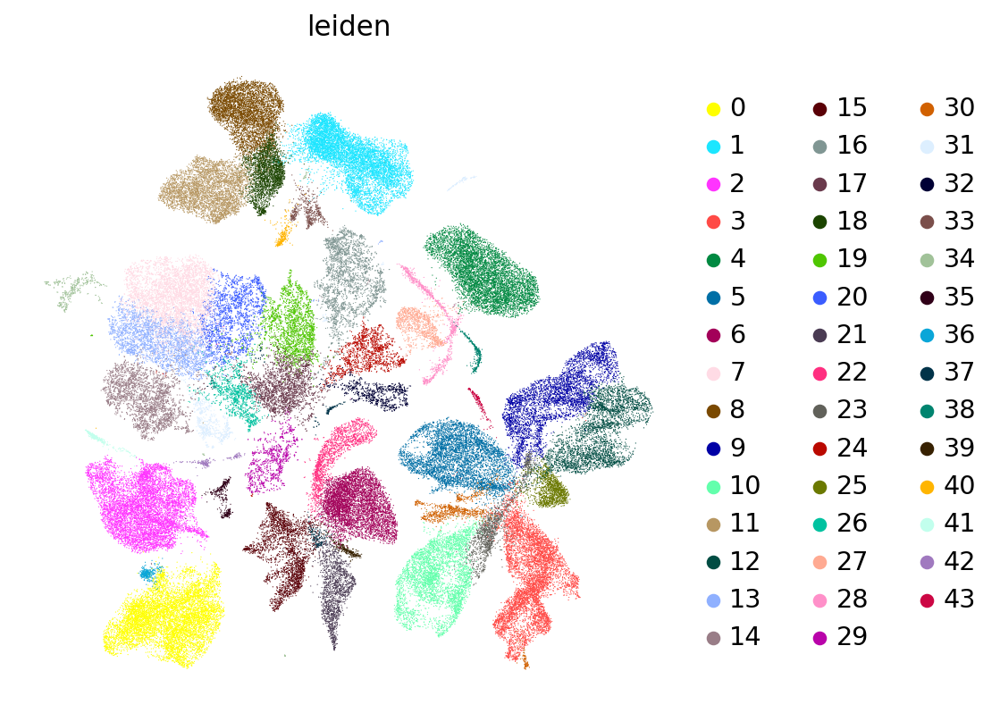

In [22]:
sc.pl.umap(adata, color = ['leiden'], frameon = False)

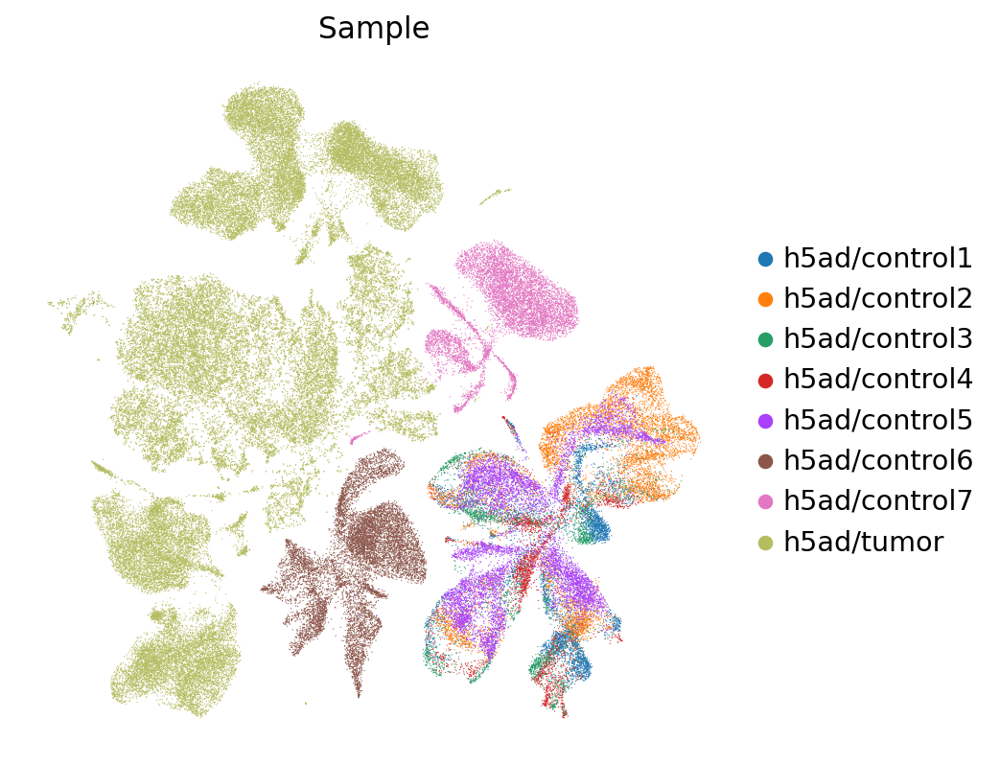

In [23]:
sc.pl.umap(adata, color = ['Sample'], frameon = False)

----
**Guardar datos integrados y el modelo SCVI**
- Guarda los datos integrados como `P3_integrated.h5ad`.
- Guarda el modelo SCVI y su configuración.

In [24]:
adata.write_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/P3_integrated.h5ad')

In [25]:
#Save scVI model
save_dir = '/home/mcgonzalez/Servicio_Social/Data/adata_saved/'

model_dir = os.path.join(save_dir, "saved_model")

model.save(model_dir, save_anndata=True)

Este código identifica dobletes, filtra y normaliza datos, integra múltiples muestras eliminando efectos de lotes y finalmente realiza una visualización y análisis de clústeres. Utiliza SCVI para aprender una representación latente de las células y aborda la corrección de efectos de lotes mediante el uso de covariables.

---------

**<span style="color:steelblue">Análisis Posterior en scRNA-seq:</span>**

Tras el preprocesamiento de datos en scRNA-seq, se emplean métodos de análisis descendente que extraen información biológica y modelan el sistema biológico subyacente, en dos enfoques principales: a nivel celular y genético.

**Análisis a Nivel Celular:**

1. **Agrupamiento de Células**:
   - **Propósito**: Determinar grupos de células con perfiles de expresión similares, lo cual ayuda a inferir su identidad y tipo.
   - **Métodos**:
     - **K-medias**: Algoritmo clásico de aprendizaje no supervisado que agrupa células minimizando distancias entre clústeres. Requiere una estimación inicial del número de clústeres y usa diferentes métricas de similitud, como la similitud de coseno y métricas basadas en correlación.
     - **Detección de Comunidades en Grafos KNN**: Representa células como nodos en un grafo, conectando cada célula con sus K vecinas más cercanas. Este método captura la topología de los datos, y se utiliza el algoritmo **Louvain** para detectar comunidades de alta conectividad.
   
2. **Recomendaciones para el Agrupamiento**:
   - Se recomienda la detección de comunidades en grafos KNN utilizando el algoritmo **Louvain**, dada su capacidad para identificar estructuras relevantes en datos de células individuales.
   - La resolución de agrupamiento puede ajustarse para subestructuras específicas, como identificar estados celulares dentro de clústeres de tipos celulares.

**Peligros y Recomendaciones:**
- Al ajustar la resolución, es importante ser cauteloso, ya que subagrupar demasiado puede llevar a interpretar patrones creados solo por ruido en los datos.
  
**Aplicaciones:**
- **Agrupamiento**: Identificación de tipos celulares, clasificación de subpoblaciones, y exploración de heterogeneidad celular.
- **Análisis de Trayectorias**: Estudio de procesos dinámicos, como la diferenciación celular, considerando los datos como una "instantánea" del proceso.

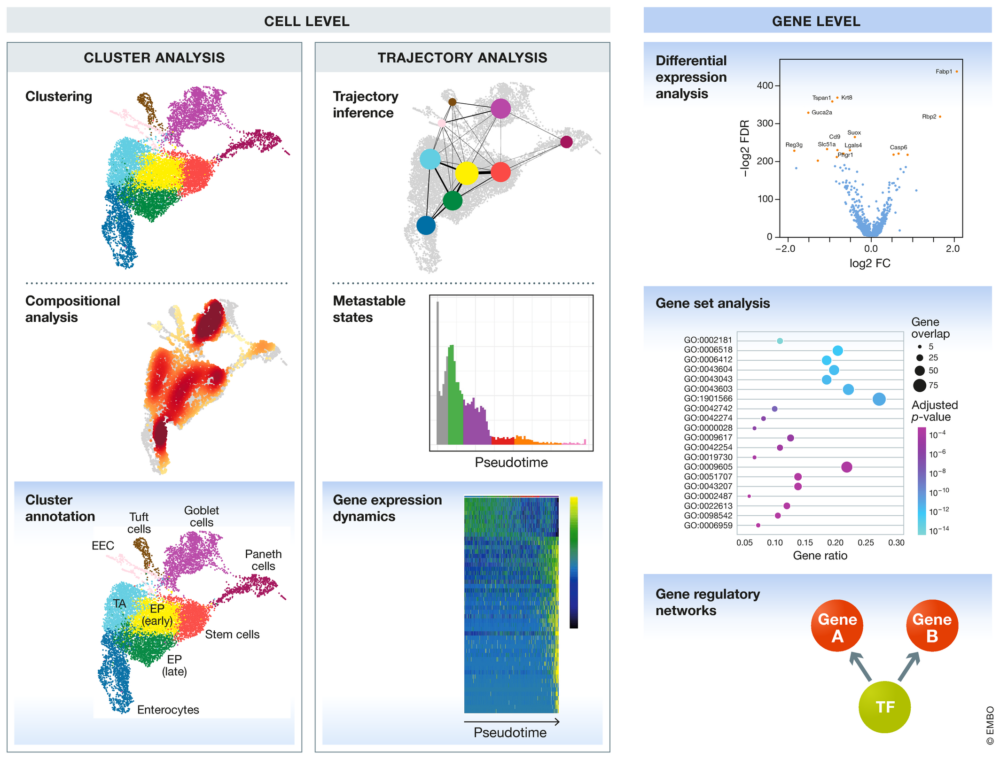

**Descripción general de los métodos de análisis posteriores** [Malte, D. L. & Fabián, J. Th. (2019) *Current best practices in single‐cell RNA‐seq analysis: a tutorial* Mol Syst Biol, 15: e8746 https://doi.org/10.15252/msb.20188746 ]

-----------
# <span style="color:dodgerblue">5. Label cells</span> 

Para comprender mejor los datos es importante determinar la *identidad celular* de cada una de las células, cuyo proceso se le conoce como **anotación celular** dado a que se etiquetan los gruos de células de los datos en función de los fenotipos celulares que se conocen (tipos de células).

Para anotar células en datos de células individuales existen dos maneras de hacerlo:

1. **Anotación manual**
Este tipo de anotación se basa en un conjunto pequeño de genes marcados que se conoce que se encuentran asociados con un tipo celular en particular. No obstante, cuando no existen marcadores únicos para un tipo celular específico, este método suele tener discrepancias con las combinaciones de marcadores o umbrales de expresión génica para una antoación adecuada. Es por ello que los datos comunmente se agrupan antes de realizar la anotación a manera de anotar grupos de céulas y no célula por célula. Dicha agrupación permite detectar células muy parecidas en la expresión gpenica general de los datos, y por tanto, explica las pérdidas a nivel de céulas indviduales.

La anotación manual se puede realizar de dos formas:

a) **De los marcadores a la anotación de grupos:** Trabajando a partir de una tabla de genes marcadores para todos los tipos de células que se esperan en los datos.

b) **Genes expresados diferencialmente e grupos de anotación de grupos:** Verificando qué genes se sobre expresan en los grupos definidos y revisando si se encuentran asociados con tipos o estados celulares ya conocidos.


2. **Anotación automática**
En este caso, la calidad de las anotaciones que se generan automaticamente varía, pues depende de lo siguiente:
- El tipo de claisficador seleccionado
- La calidad de los datos con los que se entrenó en clasificador; esto implica una buena anotación dado a que los datos anotados con baja resolución o ruidosos, provocan que el clasificador no funcione correctamente.
- La similitud de los propios datos con los datos con los que se entrenó el clasificador.

La anotación automática no requiere necesraiamente la descarga ni el procesamientos de los datos de entrenamiento, comunmente solo requiere de la carga de datos a una página web en línea y además, no dependen de las particiones de datos en grupos con en la anotación manual.

a) **Clasificadores basados en genes marcadores**

b) **Clasificadores basados en un conjunto más amplio de genes**

c) **Anotación mediante mapeo a una referencia**

-----------

### <span style="color:navy">4.0 Configuración del entorno y datos</span> 

Estos paquetes son para manejo de archivos y descargas:
   - **gdown**: facilita la descarga de archivos desde Google Drive.
   - **os**: ayuda a interactuar con el sistema de archivos.
   - **gzip** y **shutil**: se usan para comprimir/descomprimir archivos y mover/copiar archivos en el sistema.

Estos paquetes son esenciales para la gestión de datos y la visualización:
   - **pandas** y **numpy**: manipulación y análisis de datos.
   - **scipy.sparse**: manejo de matrices dispersas, comunes en secuenciación de ARN.
   - **matplotlib.pyplot**: permite la creación de gráficos.
   - **anndata**: estructura de datos que gestiona grandes conjuntos de datos de una sola célula.
   - **scanpy**: principal biblioteca para análisis de datos de secuenciación de ARN de una sola célula.
   - **seaborn**: mejora la visualización de gráficos.
   -  **scvi**: paquete para modelos de inferencia variacional, aquí ayuda a detectar efectos biológicos en datos ruidosos.
   - **SOLO**: herramienta de scVI para identificar células de fondo (doublets).

In [2]:
#For downloads
import gdown, os, gzip, shutil

# Basic data management and plotting
import pandas as pd
import numpy as np
from scipy import sparse
import matplotlib.pyplot as plt
import os

# Scanpy fundamentals
import anndata as ad
import scanpy as sc
import seaborn as sb

# sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(figsize=(6, 6))
import scvi
from scvi.external import SOLO

/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


-------
## <span style="color:navy">5.1 Find markers/ label cell types</span> 
### Búsqueda de marcadores celulares mediante valores de cambio de pliegue logarítmico (lfc)

 Se carga un archivo de datos previamente guardado en formato **h5ad**, específico de **Scanpy**.

In [3]:
adata = sc.read_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/P3_integrated.h5ad')

Se carga un modelo previamente entrenado para análisis de expresión diferencial usando **scVI**.

In [4]:
model_dir = '/home/mcgonzalez/Servicio_Social/Data/adata_saved/saved_model/'
model = scvi.model.SCVI.load(model_dir)

INFO     File /home/mcgonzalez/Servicio_Social/Data/adata_saved/saved_model/model.pt already downloaded            


/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/s ...
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scvi/model/base/_save_load.py:76: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be

-----
**Análisis y visualización de datos**

- **sc.tl.umap**: calcula un mapeo UMAP, que reduce la dimensionalidad y facilita la visualización.
- **sc.tl.leiden**: aplica el algoritmo de clustering Leiden para identificar grupos de células (clusters) en los datos.

In [5]:
sc.tl.umap(adata)
sc.tl.leiden(adata, resolution = 1)

/tmp/ipykernel_3070854/1945760328.py:2: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution = 1)


Estos gráficos muestran los datos de UMAP, coloreando por clusters y por muestra.

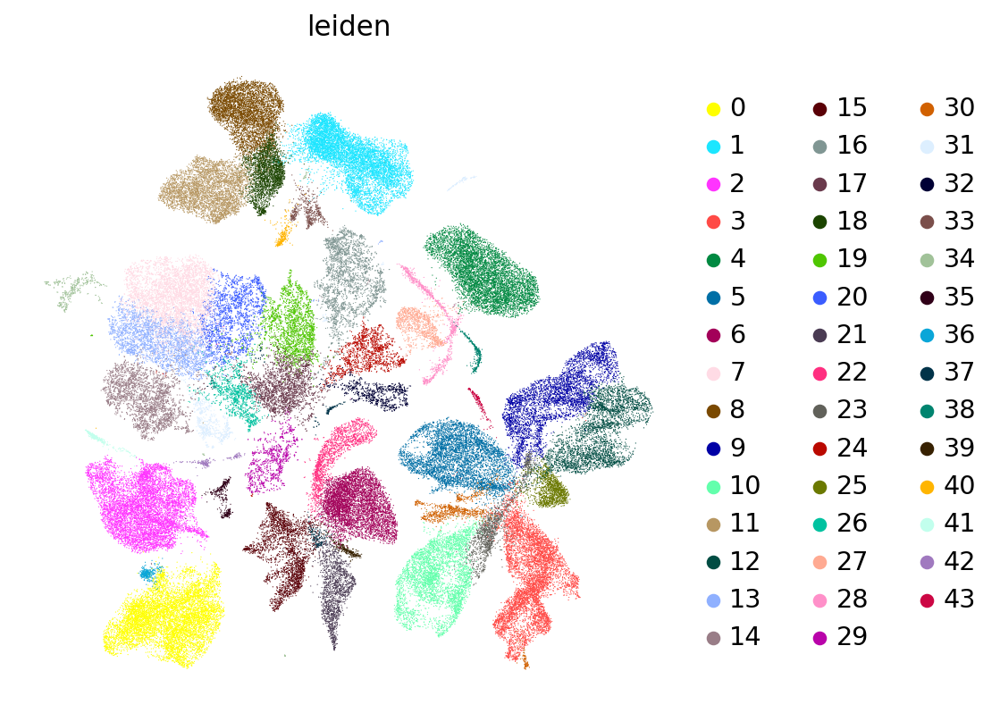

In [6]:
sc.pl.umap(adata, color = ['leiden'], frameon = False)

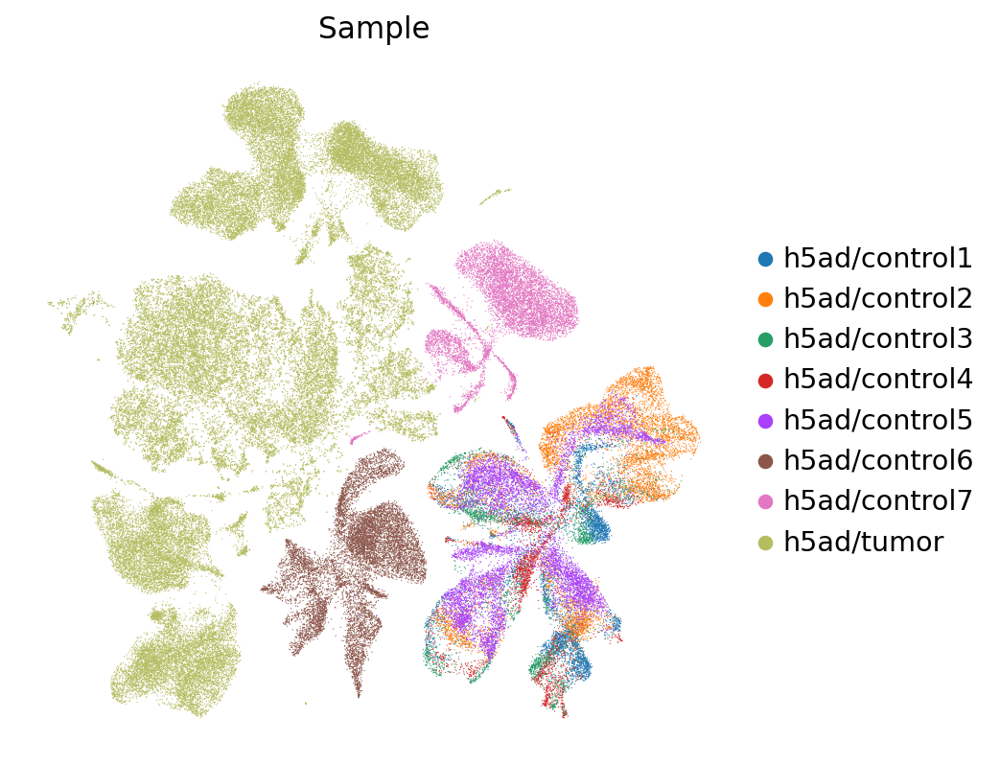

In [7]:
sc.pl.umap(adata, color = ['Sample'], frameon = False)

------
**Identificación de genes marcadores**

Calcula los genes marcadores para cada cluster usando la prueba de Wilcoxon.

### <span style="color:lightskyblue">Prueba de Wilcoxon</span> 

La **prueba de Wilcoxon**, también conocida como **prueba de Wilcoxon de rangos con signo**, es una prueba no paramétrica utilizada para comparar dos muestras relacionadas o pares de observaciones. La prueba evalúa si las diferencias entre los pares de datos siguen una distribución simétrica alrededor de cero, sin asumir una distribución específica para los datos (como la normalidad). En el contexto de secuenciación de ARN de una sola célula, se usa para evaluar si ciertos genes están diferencialmente expresados entre distintos grupos de células.

**Supuestos de la Prueba de Wilcoxon**
   - Los datos deben estar en pares (por ejemplo, expresión de genes en distintos clusters).
   - Las diferencias entre los pares deben ser ordinales o continuas.
   - Las diferencias deben tener una distribución simétrica alrededor de cero.

**Formulación Matemática**

Para una muestra de pares $(x_1, y_1)$, $(x_2, y_2)$, $\dots$, $(x_n, y_n)$, donde cada $x_i$ y $y_i$ representan dos valores observados de una misma entidad (por ejemplo, la expresión de un gen en dos grupos de células):

1. **Calcular las diferencias** $d_i$:
   $$d_i = y_i - x_i$$
   para cada par $i = 1, 2, \dots, n$.

2. **Eliminar diferencias de valor cero**:
   Si $d_i = 0$, se elimina el par de observaciones, ya que no contribuye al análisis.

3. **Asignar rangos a los valores absolutos de las diferencias**:
   Ordena los valores absolutos $|d_i|$ en orden ascendente y asigna rangos $R_i$ a estos valores. Si hay empates (diferencias absolutas iguales), se les asigna el rango promedio.

4. **Aplicar los signos originales a los rangos**:
   Los rangos se asignan con el signo de la diferencia original $d_i$:
   $$R_i^* = \text{signo}(d_i) \times R_i$$
   donde $\text{signo}(d_i) = 1$ si $d_i > 0$ y $\text{signo}(d_i) = -1$ si $d_i < 0$.

5. **Calcular el estadístico de Wilcoxon**:
   El estadístico $W$ es la suma de los rangos positivos o negativos (ya que son iguales en magnitud):
   $$W = \sum_{\text{todos los } i} R_i^*$$

**Interpretación del Estadístico de Wilcoxon**

El valor de $W$ se compara con un valor crítico de una tabla de Wilcoxon para un nivel de significancia dado $\alpha$; usualmente 0.05. Si $W$ es mayor o igual que el valor crítico, se rechaza la hipótesis nula (que establece que la mediana de las diferencias es cero), indicando que existe una diferencia significativa entre las dos muestras.

Para muestras grandes $(n > 20)$, la distribución de $W$ se aproxima a una normal. Entonces, el estadístico puede ser transformado en una puntuación **Z**:
$$Z = \frac{W - \mu_W}{\sigma_W}$$
donde $\mu_W$ y $\sigma_W$ son la media y desviación estándar de $W$, respectivamente, calculadas como:
$$\mu_W = \frac{n(n+1)}{4}, \quad \sigma_W = \sqrt{\frac{n(n+1)(2n+1)}{24}}$$
Luego, el valor de $Z$ se usa para evaluar significancia en una distribución normal estándar.

**Aplicación en el Código de Secuenciación de ARN**

En el código, la prueba de Wilcoxon se utiliza con el método `sc.tl.rank_genes_groups` para identificar los genes que son diferencialmente expresados en los distintos clusters de células. Aquí, cada grupo de células se compara con otro en términos de la expresión de genes, y la prueba de Wilcoxon permite determinar si hay diferencias significativas en la expresión de cada gen.

In [8]:
sc.tl.rank_genes_groups(adata, 'leiden', method = 'wilcoxon')

/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:435: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:437: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/mcgonzalez/miniconda3/envs/SS/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:440: Perf

Grafica los genes más representativos para cada grupo.

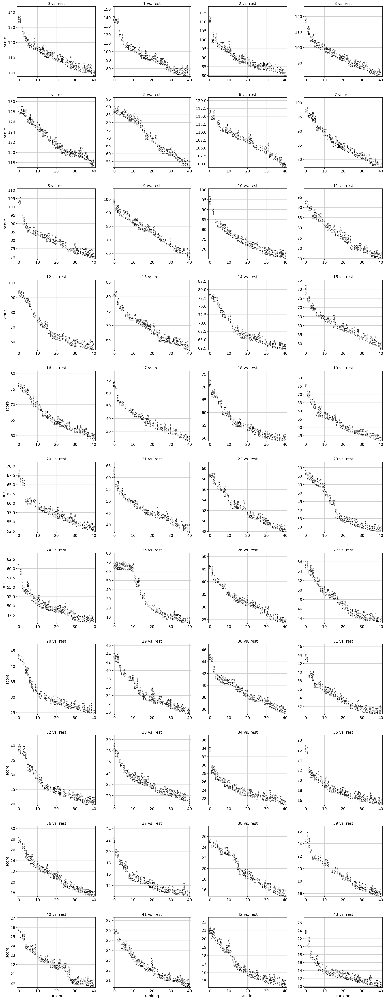

In [9]:
sc.pl.rank_genes_groups(adata, n_genes=41, sharey=False)

Obtiene una tabla de genes marcadores significativos y filtra aquellos con valores de **p** ajustados menores a 0.05 y cambios de pliegue logarítmicos mayores a 1.5.

In [10]:
markers = sc.get.rank_genes_groups_df(adata, None)
markers = markers[(markers.pvals_adj < 0.05) & (markers.logfoldchanges > 1.5)]
markers

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,0,MAP4K4,133.092239,3.867145,0.000000,0.000000
1,0,ZNRF3,132.807541,4.269325,0.000000,0.000000
2,0,RNF43,126.749039,4.283255,0.000000,0.000000
3,0,RERE,123.914764,3.476442,0.000000,0.000000
4,0,GLDC,120.742638,3.869599,0.000000,0.000000
...,...,...,...,...,...,...
505948,43,YOD1,2.564887,2.109281,0.010321,0.024231
505952,43,MBOAT2,2.484045,1.787422,0.012990,0.029685
505956,43,TUBG1,2.342327,2.284255,0.019164,0.041950
505959,43,FAM214B,2.299329,2.945832,0.021486,0.046388


---------
**Análisis de expresión diferencial con scVI**

Usando **scVI**, calcula los genes diferencialmente expresados por cluster.

In [11]:
markers_scvi = model.differential_expression(groupby = 'leiden')
markers_scvi

DE...: 100%|█████████████████████████████████| 44/44 [2:12:02<00:00, 180.07s/it]


,proba_de,proba_not_de,bayes_factor,scale1,scale2,pseudocounts,delta,lfc_mean,lfc_median,lfc_std,...,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,is_de_fdr_0.05,comparison,group1,group2
SH2B1,0.9984,0.0016,6.436144,0.000114,0.000026,0.0,0.25,2.526505,2.156833,1.262144,...,0.574710,0.120624,0.402288,0.102293,1.129581,0.244934,True,0 vs Rest,0,Rest
KCTD13,0.9984,0.0016,6.436144,0.000090,0.000021,0.0,0.25,2.853511,2.258657,1.789508,...,0.411475,0.112865,0.309698,0.092301,0.818334,0.191592,True,0 vs Rest,0,Rest
ZNF500,0.9984,0.0016,6.436144,0.000078,0.000012,0.0,0.25,3.184461,2.931333,1.381924,...,0.361852,0.055956,0.278968,0.050440,0.697641,0.106250,True,0 vs Rest,0,Rest
TMEM143,0.9982,0.0018,6.318161,0.000119,0.000015,0.0,0.25,3.453859,3.281209,1.315370,...,0.541849,0.056663,0.362778,0.049150,1.066266,0.111386,True,0 vs Rest,0,Rest
ASB16-AS1,0.9980,0.0020,6.212601,0.000043,0.000010,0.0,0.25,2.515398,2.236265,1.252807,...,0.217642,0.040990,0.186777,0.037961,0.418335,0.084409,True,0 vs Rest,0,Rest
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TXNL1,0.7772,0.2228,1.249423,0.000051,0.000053,0.0,0.25,-0.111405,-0.104588,1.028011,...,0.193370,0.239571,0.165746,0.185172,0.519030,0.536503,True,43 vs Rest,43,Rest
RNF11,0.7682,0.2318,1.198175,0.000057,0.000044,0.0,0.25,0.352845,0.318301,0.872813,...,0.309392,0.199065,0.220994,0.158366,0.938449,0.479940,True,43 vs Rest,43,Rest
CAPZA2,0.7670,0.2330,1.191448,0.000120,0.000144,0.0,0.25,-0.260033,-0.161991,1.050926,...,0.408840,0.588073,0.220994,0.345233,1.044174,1.350440,True,43 vs Rest,43,Rest
C1D,0.7632,0.2368,1.170304,0.000044,0.000043,0.0,0.25,-0.030399,0.005320,1.004650,...,0.198895,0.182031,0.165746,0.148425,0.641229,0.438385,True,43 vs Rest,43,Rest


Filtra los resultados de scVI por significancia y cambio de pliegue logarítmico.

In [12]:
markers_scvi = markers_scvi[(markers_scvi['is_de_fdr_0.05']) & (markers_scvi.lfc_mean > 1.5)]
markers_scvi

,proba_de,proba_not_de,bayes_factor,scale1,scale2,pseudocounts,delta,lfc_mean,lfc_median,lfc_std,...,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,is_de_fdr_0.05,comparison,group1,group2
SH2B1,0.9984,0.0016,6.436144,0.000114,0.000026,0.0,0.25,2.526505,2.156833,1.262144,...,0.574710,0.120624,0.402288,0.102293,1.129581,0.244934,True,0 vs Rest,0,Rest
KCTD13,0.9984,0.0016,6.436144,0.000090,0.000021,0.0,0.25,2.853511,2.258657,1.789508,...,0.411475,0.112865,0.309698,0.092301,0.818334,0.191592,True,0 vs Rest,0,Rest
ZNF500,0.9984,0.0016,6.436144,0.000078,0.000012,0.0,0.25,3.184461,2.931333,1.381924,...,0.361852,0.055956,0.278968,0.050440,0.697641,0.106250,True,0 vs Rest,0,Rest
TMEM143,0.9982,0.0018,6.318161,0.000119,0.000015,0.0,0.25,3.453859,3.281209,1.315370,...,0.541849,0.056663,0.362778,0.049150,1.066266,0.111386,True,0 vs Rest,0,Rest
ASB16-AS1,0.9980,0.0020,6.212601,0.000043,0.000010,0.0,0.25,2.515398,2.236265,1.252807,...,0.217642,0.040990,0.186777,0.037961,0.418335,0.084409,True,0 vs Rest,0,Rest
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MXI1,0.9236,0.0764,2.492296,0.000143,0.000041,0.0,0.25,1.690982,1.672694,1.485041,...,0.640884,0.171709,0.386740,0.129723,1.893224,0.361997,True,43 vs Rest,43,Rest
MAP1LC3B,0.9230,0.0770,2.483824,0.000154,0.000048,0.0,0.25,1.672624,1.654264,1.299274,...,0.828730,0.192105,0.392265,0.145149,2.515775,0.538297,True,43 vs Rest,43,Rest
SVBP,0.9200,0.0800,2.442347,0.000048,0.000018,0.0,0.25,1.523738,1.550770,1.149684,...,0.243094,0.052219,0.182320,0.048193,0.681852,0.151304,True,43 vs Rest,43,Rest
RILP,0.9182,0.0818,2.418138,0.000028,0.000011,0.0,0.25,1.594475,1.643301,1.520004,...,0.110497,0.030433,0.099448,0.028653,0.280209,0.092838,True,43 vs Rest,43,Rest


-------
**Visualización adicional y guardado de resultados**

Muestra nuevamente UMAP para los clusters y colorea por un marcador celular específico (EPCAM), utilizando datos normalizados por **scVI**.

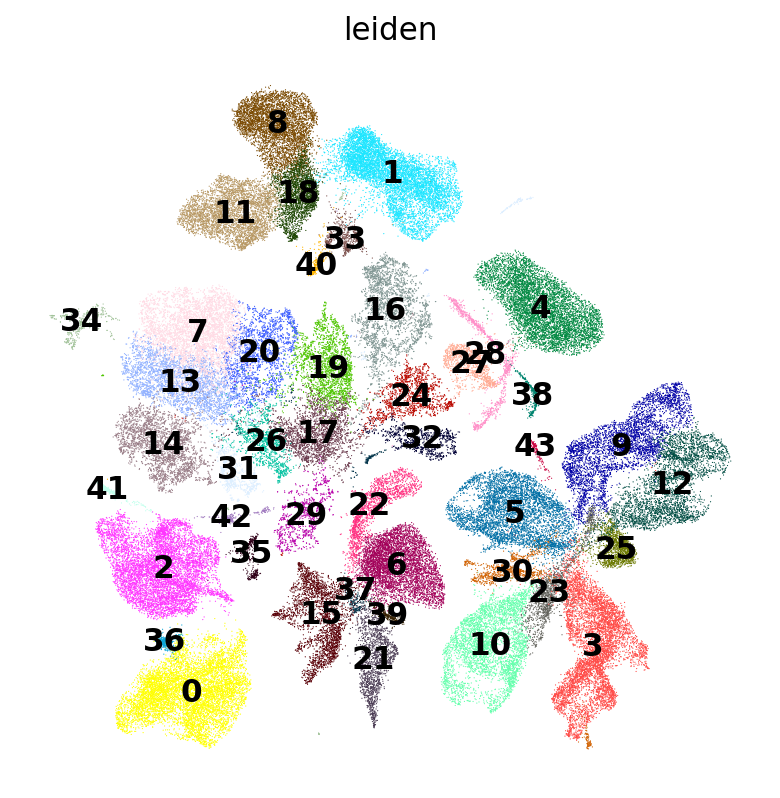

In [13]:
sc.pl.umap(adata, color = ['leiden'], frameon = False, legend_loc = "on data")

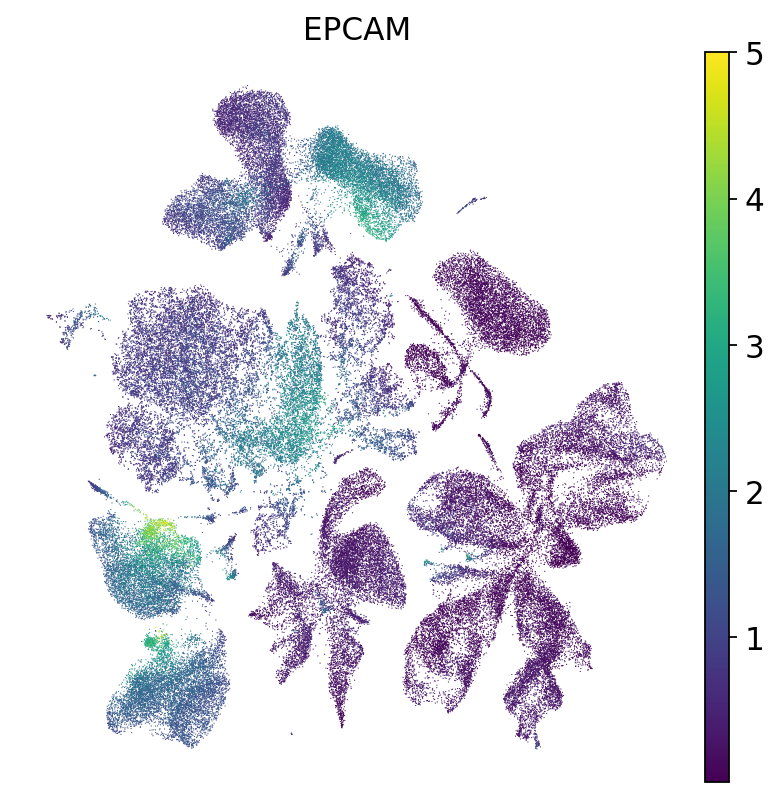

In [14]:
sc.pl.umap(adata, color = ['EPCAM'], frameon = False, layer = 'scvi_normalized', vmax = 5)

Guarda el objeto **adata** actualizado en un nuevo archivo **h5ad**.

In [15]:
adata.write_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/P4_markers.h5ad')

In [16]:
adata

AnnData object with n_obs × n_vars = 105197 × 11762
    obs: 'n_genes', 'Sample', 'doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', '_scvi_batch', '_scvi_labels', 'leiden'
    var: 'n_cells'
    uns: 'Sample_colors', '_scvi_manager_uuid', '_scvi_uuid', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'umap', 'rank_genes_groups'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    layers: 'counts', 'scvi_normalized'
    obsp: 'connectivities', 'distances'

-------
## <span style="color:navy">5.2 Finding cell markers using log fold change (lfc) values</span>
**Anotación de clústeres**

La **anotación de clústeres** en datos de secuenciación de células individuales implica asignar una identidad biológica significativa a los grupos de células (clusters) obtenidos en el análisis. Este proceso se basa en la identificación de genes marcadores característicos de cada grupo y permite entender la identidad de las células de acuerdo con sus patrones de expresión genética. A continuación se detallan los principales aspectos, métodos y recomendaciones para una anotación precisa.

**Principios de la Anotación de Clústeres**

- **Identidad celular**: Los clústeres suelen reflejar “identidades celulares” más que tipos celulares específicos. Estas identidades pueden representar distintos estados celulares, subtipos o variaciones en el mismo tipo celular. La resolución de la anotación dependerá del nivel de detalle requerido para el estudio.

**Métodos para Anotación de Clústeres**

1. **Identificación de Genes Marcadores**:
   - Se realiza **expresión diferencial** (DE) entre un grupo y el resto de los datos, enfocándose en genes con expresión significativamente mayor en el grupo de interés.
   - **Pruebas estadísticas** como la prueba de suma de rangos de Wilcoxon o la prueba t son comunes para clasificar genes de acuerdo con la diferencia en expresión. Los genes mejor clasificados se consideran candidatos a genes marcadores.

2. **Uso de Bases de Datos de Referencia**:
   - **Atlas y bases de datos** como el Atlas de Células Humanas o el atlas del cerebro del ratón permiten la comparación directa de genes marcadores en los datos de referencia para facilitar la anotación.
   - Comparar los genes marcadores identificados con bases de datos como [mousebrain.org](http://mousebrain.org) o [DropViz](http://dropviz.org) puede facilitar la correspondencia entre los clústeres de los datos y referencias conocidas.

3. **Herramientas de Anotación Automatizada**:
   - Herramientas como **scmap** o **Garnett** permiten realizar anotaciones automáticas al comparar directamente perfiles de expresión de clústeres de referencia y de los datos, acelerando el proceso y permitiendo una asignación aproximada de identidades celulares. Estos métodos pueden complementar la anotación manual para mejorar la precisión y profundidad.

**Aspectos Clave en la Selección de Genes Marcadores**

1. **Valores P en Genes Marcadores**:
   - Los valores P pueden ser inflados si los clústeres y genes marcadores se determinan en el mismo conjunto de datos. En estos casos, es preferible usar **pruebas de permutación** para controlar el efecto de agrupamiento. Alternativamente, una inspección visual de los genes marcadores también puede ayudar a evaluar su relevancia.

2. **Composición del Conjunto de Datos**:
   - Los genes marcadores dependen de la composición del conjunto de datos, por lo que una baja diversidad puede sesgar la selección hacia lo que está ausente en los datos. Esto es especialmente relevante para conjuntos de datos que no capturan toda la variedad esperada en una muestra biológica.

**Recomendaciones y Buenas Prácticas**

- **Combinar métodos manuales y automatizados**: Para conjuntos de datos grandes o aquellos sin atlas de referencia exactos, es ideal utilizar anotación automática para una asignación inicial de identidades celulares, complementándola luego con un análisis manual de genes marcadores.
- **Evitar la dependencia de valores P para validar identidades celulares**: Los valores P inflados pueden llevar a conclusiones incorrectas, especialmente si los genes marcadores no coinciden con identidades celulares conocidas.
- **Personalizar según los datos**: La diversidad celular en los datos y la disponibilidad de referencias determinarán la mejor combinación de métodos y niveles de resolución para cada estudio.

**<span style="color:indianred">Puntos a considerar:</span>**
- No usar los valores P de los genes marcadores para validar clústeres si los marcadores no representan claramente la comunidad, ya que los valores P pueden estar inflados.
- Los genes marcadores pueden variar entre conjuntos de datos según el tipo de célula y la composición.
- Para una anotación eficiente, usar una combinación de anotación automatizada y manual si existen bases de datos de referencia relevantes, con genes marcadores específicos para confirmar las identidades celulares.

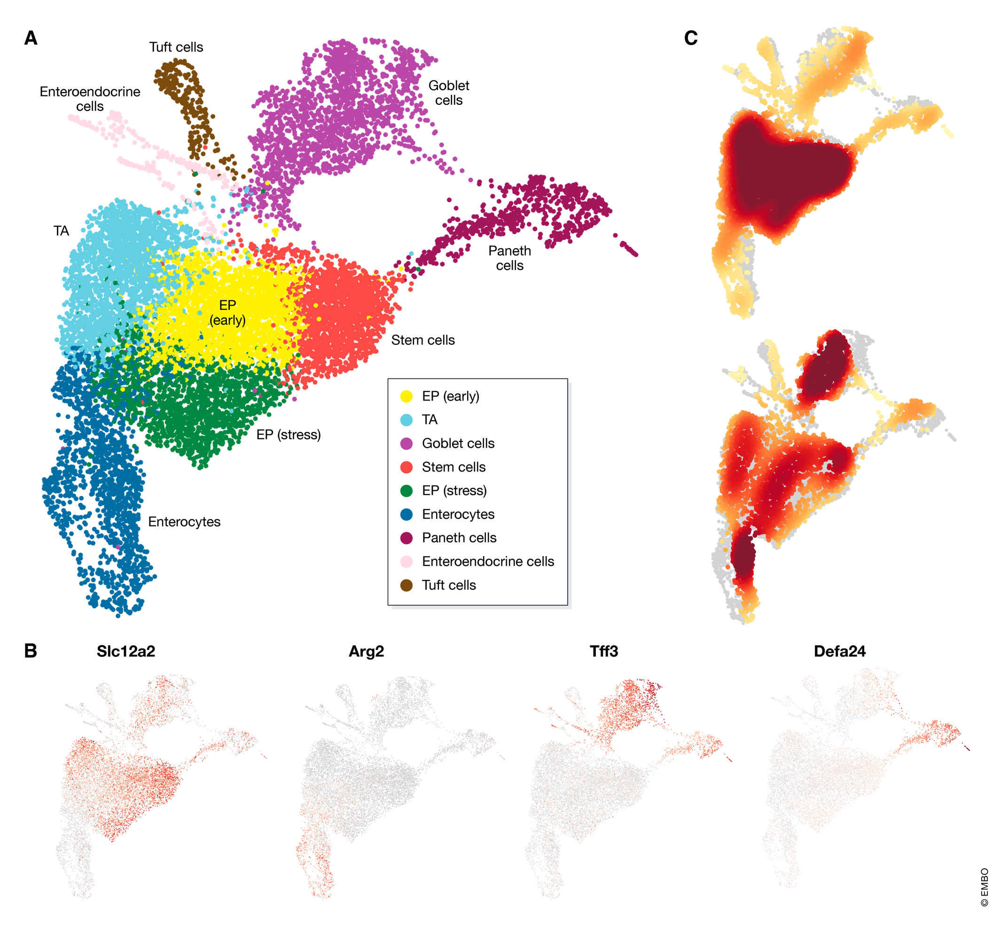

**Resultados del análisis de conglomerados del conjunto de datos** [Malte, D. L. & Fabián, J. Th. (2019) *Current best practices in single‐cell RNA‐seq analysis: a tutorial* Mol Syst Biol, 15: e8746 https://doi.org/10.15252/msb.20188746 ]

----------- 
### <span style="color:lightskyblue">Identificación de marcadores celulares mediante valores de cambio de pliegue logarítmico (lfc)</span> 

Los **valores de cambio de pliegue logarítmico** (log fold change, o **lfc**) son una medida que describe el cambio relativo en la expresión de un gen entre dos condiciones, como entre dos grupos de células o dos estados (por ejemplo, células sanas; control, vs. células enfermas; tumor). Específicamente, indica cuántas veces aumenta o disminuye la expresión de un gen entre estas condiciones. 

El cambio de pliegue simple (fold change) se calcula como la relación entre la expresión del gen en una condición y su expresión en la otra. Sin embargo, el cambio de pliegue logarítmico implica tomar el logaritmo de esta relación, lo cual tiene ventajas importantes.

**Fórmula del Cambio de Pliegue Logarítmico (lfc)**
Si tenemos:
- $A$: expresión del gen en la primera condición.
- $B$: expresión del gen en la segunda condición.

Entonces, el cambio de pliegue (fold change) sería $\frac{B}{A}$

Para el cambio de pliegue logarítmico, se usa generalmente el logaritmo en base 2:
$$\text{log fold change} = \log_2 \left(\frac{B}{A}\right)$$

**Interpretación del Cambio de Pliegue Logarítmico**
- Un **lfc positivo** indica que el gen está **sobreexpresado** en la segunda condición (B) en comparación con la primera (A). Por ejemplo, si el lfc es 2, significa que la expresión del gen es $2^2 = 4$ veces mayor en B que en A.
- Un **lfc negativo** indica que el gen está **subexpresado** en la segunda condición en comparación con la primera. Un lfc de -1, por ejemplo, significa que la expresión en B es $2^{-1} = \frac{1}{2}$, o la mitad de la expresión en A.
- Un **lfc de 0** indica que no hay diferencia en la expresión entre ambas condiciones.

**¿Por Qué usar el Cambio de Pliegue Logarítmico?**
- **Simetría**: La escala logarítmica permite representar aumentos y disminuciones de manera simétrica. Por ejemplo, un aumento de 4 veces y una disminución de un cuarto (1/4) de la expresión tienen valores lfc simétricos (2 y -2, respectivamente).
- **Compresión de valores extremos**: La escala logarítmica reduce la influencia de valores extremadamente grandes o pequeños, lo cual ayuda en el análisis y visualización de datos de expresión.

--------

**En el Contexto de Análisis de ARN de Célula Única**

En estudios de secuenciación de ARN de una sola célula, el lfc ayuda a identificar **genes marcadores** que tienen una expresión diferencial significativa entre tipos de células. Para definir qué genes están más asociados con un tipo celular específico, se aplican umbrales de lfc para resaltar aquellos que muestran los cambios más relevantes en la expresión entre grupos de células.

En este estudio, la anotación manual de células se utilizó para etiquetar los tipos celulares, basándose en el análisis de cambios de pliegue logarítmico para identificar genes altamente expresados en cada grupo. Para asegurar una identificación precisa de los tipos celulares en cada agrupamiento, se implementó un enfoque sistemático. Se aplicaron sucesivamente varios umbrales de cambio de pliegue logarítmico (2.0, 2.5, 3.5, 4.0, 5.0, 6.5, 7.5), lo que permitió una evaluación detallada de los patrones de expresión génica.

Este proceso iterativo consideró las variaciones en los niveles de expresión génica en los diferentes grupos, asegurando que solo los genes más informativos y distintivos fueran tomados en cuenta para la asignación de tipos celulares. Al incrementar gradualmente el umbral de cambio de pliegue logarítmico, de valores bajos a altos, el método de anotación capturó variaciones sutiles en la expresión génica, delineando con mayor precisión las poblaciones celulares. Este enfoque favoreció la identificación sólida de tipos celulares y mejoró la relevancia biológica de los resultados de anotación.

Cabe destacar que los marcadores para células hepáticas e inmunes se obtuvieron de la base de datos Panglao [https://panglaodb.se]

In [ ]:
adata = sc.read_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/P4_markers.h5ad')

In [ ]:
markers.to_csv("/datos/home/jupyter-mdiaz/scRNAseq_pipeline/markers/markers.csv", index=False)

----------
## <span style="color:navy">Integration with scVI</span>

In [1]:
#For downloads
import gdown, os, gzip, shutil

# Basic data management and plotting
import pandas as pd
import numpy as np
from scipy import sparse
import matplotlib.pyplot as plt
import os

# Scanpy fundamentals
import anndata as ad
import scanpy as sc
import seaborn as sb

# sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(figsize=(6, 6))
import scvi
from scvi.external import SOLO

/home/mcgonzalez/miniconda3/envs/Servicio/lib/python3.10/site-packages/anndata/utils.py:429: FutureWarning: Importing read_csv from `anndata` is deprecated. Import anndata.io.read_csv instead.
  warnings.warn(msg, FutureWarning)
/home/mcgonzalez/miniconda3/envs/Servicio/lib/python3.10/site-packages/anndata/utils.py:429: FutureWarning: Importing read_loom from `anndata` is deprecated. Import anndata.io.read_loom instead.
  warnings.warn(msg, FutureWarning)
/home/mcgonzalez/miniconda3/envs/Servicio/lib/python3.10/site-packages/anndata/utils.py:429: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  warnings.warn(msg, FutureWarning)
/home/mcgonzalez/miniconda3/envs/Servicio/lib/python3.10/site-packages/anndata/utils.py:429: FutureWarning: Importing CSCDataset from `anndata.experimental` is deprecated. Import anndata.abc.CSCDataset instead.
  warnings.warn(msg, FutureWarning)
/home/mcgonzalez/miniconda3/envs/Servicio/lib/python3.10/site-

In [2]:
adata = sc.read_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/P3_integrated.h5ad')

In [3]:
scvi.model.SCVI.setup_anndata(adata, layer = "counts",
                             categorical_covariate_keys=["Sample"],
                             continuous_covariate_keys=['pct_counts_mt', 'total_counts'])

In [4]:
model=scvi.model.SCVI(adata, n_layers=2, n_latent=30, gene_likelihood='nb')

In [5]:
model.train()

/home/mcgonzalez/miniconda3/envs/Servicio/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/Servicio/lib/python ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/mcgonzalez/miniconda3/envs/Servicio/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/Servicio/lib/python ...
/home/mcgonzalez/miniconda3/envs/Servicio/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have man

Epoch 76/76: 100%|█| 76/76 [45:38<00:00, 31.42s/it, v_num=1, train_loss_step=4.9

`Trainer.fit` stopped: `max_epochs=76` reached.


Epoch 76/76: 100%|█| 76/76 [45:38<00:00, 36.03s/it, v_num=1, train_loss_step=4.9


In [6]:
adata

AnnData object with n_obs × n_vars = 105197 × 11762
    obs: 'n_genes', 'Sample', 'doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', '_scvi_batch', '_scvi_labels', 'leiden'
    var: 'n_cells'
    uns: 'Sample_colors', '_scvi_manager_uuid', '_scvi_uuid', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'umap'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    layers: 'counts', 'scvi_normalized'
    obsp: 'connectivities', 'distances'

In [7]:
SCVI_LATENT_KEY = "X_scVI"
adata.obsm[SCVI_LATENT_KEY] = model.get_latent_representation()

In [8]:
sc.pp.neighbors(adata, use_rep=SCVI_LATENT_KEY)
sc.tl.leiden(adata)

/tmp/ipykernel_2556786/2529970008.py:2: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata)


In [9]:
SCVI_MDE_KEY = "X_scVI_MDE"
adata.obsm[SCVI_MDE_KEY] = scvi.model.utils.mde(adata.obsm[SCVI_LATENT_KEY])

INFO     Using cpu for `pymde.preserve_neighbors`.                                                                 


/home/mcgonzalez/miniconda3/envs/Servicio/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/mcgonzalez/miniconda3/envs/Servicio/lib/python ...


Jan 13 01:12:14 PM: Your dataset appears to contain duplicated items (rows); when embedding, you should typically have unique items.
Jan 13 01:12:14 PM: The following items have duplicates [    2     4     6 ... 25144 25145 25146]


In [10]:
adata.layers['scvi_normalized']=model.get_normalized_expression(library_size = 1e4)

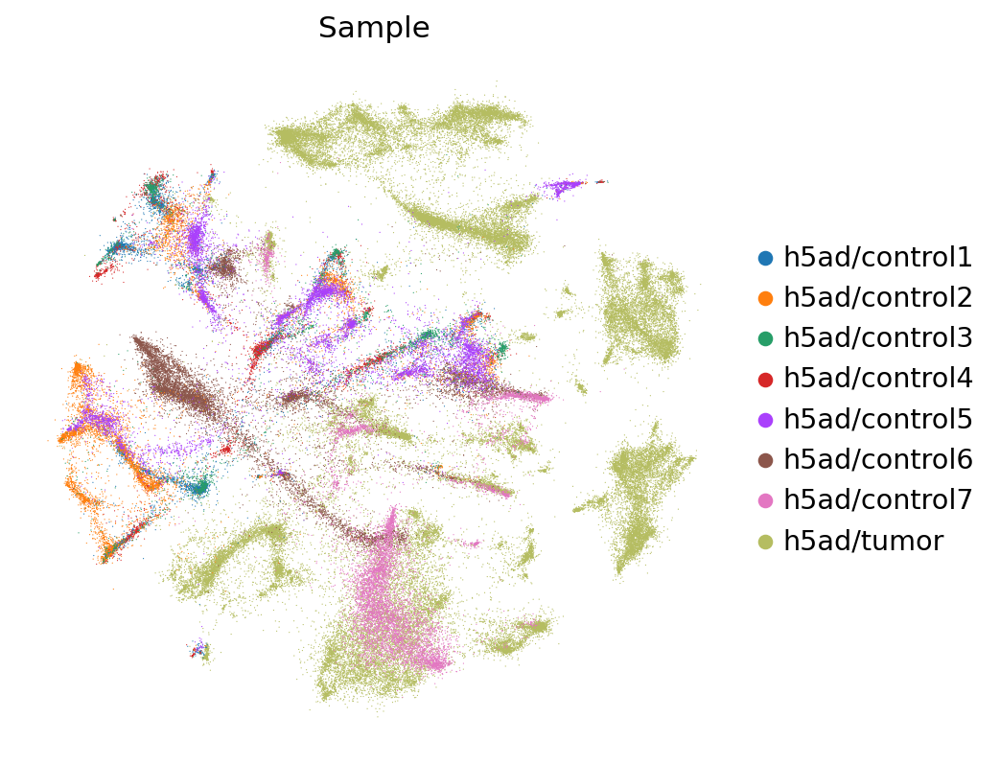

In [11]:
sc.pl.embedding(
    adata,
    basis=SCVI_MDE_KEY,
    color=["Sample"],
    frameon=False,
    ncols=1,
)

In [12]:
adata.obs

,n_genes,Sample,doublet,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,_scvi_batch,_scvi_labels,leiden
AAACCCAAGACCGCCT-1,1419,h5ad/tumor,False,1419,2097.0,0.0,0.0,0,0,19
AAACCCAAGAGGCGGA-1,808,h5ad/tumor,False,808,1059.0,0.0,0.0,0,0,26
AAACCCAAGCAGCCTC-1,1700,h5ad/tumor,False,1700,2728.0,0.0,0.0,0,0,16
AAACCCAAGCCGTTAT-1,3397,h5ad/tumor,False,3397,8238.0,0.0,0.0,0,0,30
AAACCCAAGGACGGAG-1,3444,h5ad/tumor,False,3444,8871.0,0.0,0.0,0,0,29
...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTCCTTTGC-1,5512,h5ad/control7,False,5512,22386.0,0.0,0.0,0,0,13
TTTGTTGGTCTCGGGT-1,2940,h5ad/control7,False,2940,7561.0,0.0,0.0,0,0,0
TTTGTTGGTGCCTGCA-1,3599,h5ad/control7,False,3599,10608.0,0.0,0.0,0,0,0
TTTGTTGTCAGAACCT-1,3305,h5ad/control7,False,3305,9792.0,0.0,0.0,0,0,6


In [13]:
adata.write_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/probe_integrated_2024a.h5ad')

----------
## <span style="color:navy">CellTypist</span>

In [14]:
#Para descargas
import gdown, os, gzip, shutil

# Gestión básica de datos y representación gráfica
import pandas as pd
import numpy as np
from scipy import sparse
import matplotlib.pyplot as plt
import os
 
# Scanpy fundamentals
import anndata as ad
import scanpy as sc
import seaborn as sb

# sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(figsize=(6, 6))
import scvi

In [15]:
import celltypist
from celltypist import models

In [16]:
models.models_description()

👉 Detailed model information can be found at `https://www.celltypist.org/models`


,model,description
0,Immune_All_Low.pkl,immune sub-populations combined from 20 tissue...
1,Immune_All_High.pkl,immune populations combined from 20 tissues of...
2,Adult_COVID19_PBMC.pkl,peripheral blood mononuclear cell types from C...
3,Adult_CynomolgusMacaque_Hippocampus.pkl,cell types from the hippocampus of adult cynom...
4,Adult_Human_MTG.pkl,cell types and subtypes (10x-based) from the a...
5,Adult_Human_PancreaticIslet.pkl,cell types from pancreatic islets of healthy a...
6,Adult_Human_PrefrontalCortex.pkl,cell types and subtypes from the adult human d...
7,Adult_Human_Skin.pkl,cell types from human healthy adult skin
8,Adult_Mouse_Gut.pkl,cell types in the adult mouse gut combined fro...
9,Adult_Mouse_OlfactoryBulb.pkl,cell types from the olfactory bulb of adult mice


In [39]:
model = models.Model.load('Healthy_Human_Liver.pkl')

In [40]:
model

CellTypist model with 17 cell types and 2691 features
    date: 2023-09-14 12:48:54.179790
    details: cell types from scRNA-seq and snRNA-seq of the adult human liver
    source: https://doi.org/10.1016/j.cell.2021.12.018
    version: v1
    cell types: B cells, Basophils, ..., pDCs
    features: HES4, TNFRSF18, ..., MT-CYB

In [41]:
model.cell_types

array(['B cells', 'Basophils', 'Cholangiocytes', 'Circulating NK/NKT',
       'Endothelial cells', 'Fibroblasts', 'Hepatocytes', 'Macrophages',
       'Mig.cDCs', 'Mono+mono derived cells', 'Neutrophils',
       'Plasma cells', 'Resident NK', 'T cells', 'cDC1s', 'cDC2s', 'pDCs'],
      dtype=object)

In [42]:
adata = sc.read_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/probe_integrated_2024a.h5ad')

In [43]:
adata

AnnData object with n_obs × n_vars = 105197 × 11762
    obs: 'n_genes', 'Sample', 'doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', '_scvi_batch', '_scvi_labels', 'leiden'
    var: 'n_cells'
    uns: 'Sample_colors', '_scvi_manager_uuid', '_scvi_uuid', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'umap'
    obsm: 'X_scVI', 'X_scVI_MDE', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    layers: 'counts', 'scvi_normalized'
    obsp: 'connectivities', 'distances'

In [44]:
def predict_cells(adata):
    sc.pp.filter_genes(adata, min_cells = 10)
    sc.pp.normalize_total(adata, target_sum=1e4) #not recommended for typical pp
    sc.pp.log1p(adata)

    adata.X = adata.X.toarray()
    predictions = celltypist.annotate(adata, model = 'Healthy_Human_Liver.pkl', 
                                  majority_voting = True)
    adata = predictions.to_adata()
    adata.obs["predicted_label"] = adata.obs.loc[adata.obs.index, "predicted_labels"]
    adata.obs["over_clustering"] = adata.obs.loc[adata.obs.index, "over_clustering"]
    adata.obs["majority_voting"] = adata.obs.loc[adata.obs.index, "majority_voting"]

    return adata.obs

In [45]:
dataset = adata[:105717, :]
predictions = predict_cells(dataset.copy())
print(predictions)

🔬 Input data has 105197 cells and 11762 genes
🔗 Matching reference genes in the model
🧬 2027 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 25
🗳️ Majority voting the predictions
✅ Majority voting done!


                    n_genes         Sample  doublet  n_genes_by_counts  \
AAACCCAAGACCGCCT-1     1419     h5ad/tumor    False               1419   
AAACCCAAGAGGCGGA-1      808     h5ad/tumor    False                808   
AAACCCAAGCAGCCTC-1     1700     h5ad/tumor    False               1700   
AAACCCAAGCCGTTAT-1     3397     h5ad/tumor    False               3397   
AAACCCAAGGACGGAG-1     3444     h5ad/tumor    False               3444   
...                     ...            ...      ...                ...   
TTTGTTGGTCCTTTGC-1     5512  h5ad/control7    False               5512   
TTTGTTGGTCTCGGGT-1     2940  h5ad/control7    False               2940   
TTTGTTGGTGCCTGCA-1     3599  h5ad/control7    False               3599   
TTTGTTGTCAGAACCT-1     3305  h5ad/control7    False               3305   
TTTGTTGTCCGATCTC-1     2777  h5ad/control7    False               2777   

                    total_counts  total_counts_mt  pct_counts_mt  _scvi_batch  \
AAACCCAAGACCGCCT-1        2097

In [46]:
predictions = predictions[['predicted_label', 'over_clustering', 'majority_voting']]
predictions

,predicted_label,over_clustering,majority_voting
AAACCCAAGACCGCCT-1,Hepatocytes,225,Hepatocytes
AAACCCAAGAGGCGGA-1,Hepatocytes,192,Hepatocytes
AAACCCAAGCAGCCTC-1,Cholangiocytes,256,Hepatocytes
AAACCCAAGCCGTTAT-1,Endothelial cells,281,Endothelial cells
AAACCCAAGGACGGAG-1,Hepatocytes,427,Hepatocytes
...,...,...,...
TTTGTTGGTCCTTTGC-1,Hepatocytes,266,Hepatocytes
TTTGTTGGTCTCGGGT-1,Hepatocytes,211,Hepatocytes
TTTGTTGGTGCCTGCA-1,Hepatocytes,87,Hepatocytes
TTTGTTGTCAGAACCT-1,Hepatocytes,9,Hepatocytes


In [47]:
adata

AnnData object with n_obs × n_vars = 105197 × 11762
    obs: 'n_genes', 'Sample', 'doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', '_scvi_batch', '_scvi_labels', 'leiden'
    var: 'n_cells'
    uns: 'Sample_colors', '_scvi_manager_uuid', '_scvi_uuid', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'umap'
    obsm: 'X_scVI', 'X_scVI_MDE', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    layers: 'counts', 'scvi_normalized'
    obsp: 'connectivities', 'distances'

In [48]:

# Crear DataFrames sin duplicados
obs_clean = adata.obs[~adata.obs.index.duplicated(keep='first')]
predictions_clean = predictions[~predictions.index.duplicated(keep='first')]

# Verificar nuevamente las longitudes después de eliminar duplicados
print(f"Longitud de obs_clean después de eliminar duplicados: {len(obs_clean)}")
print(f"Longitud de predictions_clean después de eliminar duplicados: {len(predictions_clean)}")

# Asegúrate de que ambos índices estén alineados
common_index = obs_clean.index.intersection(predictions_clean.index)
obs_clean = obs_clean.loc[common_index]
predictions_clean = predictions_clean.loc[common_index]

print(f"Índices comunes después de eliminar duplicados: {len(common_index)}")

# Realiza el merge
merged_obs = obs_clean.merge(right=predictions_clean, left_index=True, right_index=True)

# Crear un DataFrame temporal con los índices alineados
temp_obs = pd.DataFrame(index=adata.obs.index)
temp_obs = temp_obs.join(merged_obs, how="left")

# Verificar el resultado
print(f"Longitud final de temp_obs: {len(temp_obs)}")

Longitud de obs_clean después de eliminar duplicados: 105197
Longitud de predictions_clean después de eliminar duplicados: 105197
Índices comunes después de eliminar duplicados: 105197
Longitud final de temp_obs: 105197


In [49]:
# Asignar el DataFrame temporal a adata.obs
adata.obs = temp_obs

# Verificar el resultado final
print(f"Longitud final de adata.obs: {len(adata.obs)}")

Longitud final de adata.obs: 105197


In [50]:
adata

AnnData object with n_obs × n_vars = 105197 × 11762
    obs: 'n_genes', 'Sample', 'doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_label', 'over_clustering', 'majority_voting'
    var: 'n_cells'
    uns: 'Sample_colors', '_scvi_manager_uuid', '_scvi_uuid', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'umap'
    obsm: 'X_scVI', 'X_scVI_MDE', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    layers: 'counts', 'scvi_normalized'
    obsp: 'connectivities', 'distances'

In [51]:
for col in adata.obs.columns:
    adata.obs[col] = adata.obs[col].astype(str)

In [52]:
print(adata)

AnnData object with n_obs × n_vars = 105197 × 11762
    obs: 'n_genes', 'Sample', 'doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_label', 'over_clustering', 'majority_voting'
    var: 'n_cells'
    uns: 'Sample_colors', '_scvi_manager_uuid', '_scvi_uuid', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'umap'
    obsm: 'X_scVI', 'X_scVI_MDE', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    layers: 'counts', 'scvi_normalized'
    obsp: 'connectivities', 'distances'


In [53]:
adata.obs

,n_genes,Sample,doublet,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,_scvi_batch,_scvi_labels,leiden,predicted_label,over_clustering,majority_voting
AAACCCAAGACCGCCT-1,1419,h5ad/tumor,False,1419,2097.0,0.0,0.0,0,0,19,Hepatocytes,225,Hepatocytes
AAACCCAAGAGGCGGA-1,808,h5ad/tumor,False,808,1059.0,0.0,0.0,0,0,26,Hepatocytes,192,Hepatocytes
AAACCCAAGCAGCCTC-1,1700,h5ad/tumor,False,1700,2728.0,0.0,0.0,0,0,16,Cholangiocytes,256,Hepatocytes
AAACCCAAGCCGTTAT-1,3397,h5ad/tumor,False,3397,8238.0,0.0,0.0,0,0,30,Endothelial cells,281,Endothelial cells
AAACCCAAGGACGGAG-1,3444,h5ad/tumor,False,3444,8871.0,0.0,0.0,0,0,29,Hepatocytes,427,Hepatocytes
...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTCCTTTGC-1,5512,h5ad/control7,False,5512,22386.0,0.0,0.0,0,0,13,Hepatocytes,266,Hepatocytes
TTTGTTGGTCTCGGGT-1,2940,h5ad/control7,False,2940,7561.0,0.0,0.0,0,0,0,Hepatocytes,211,Hepatocytes
TTTGTTGGTGCCTGCA-1,3599,h5ad/control7,False,3599,10608.0,0.0,0.0,0,0,0,Hepatocytes,87,Hepatocytes
TTTGTTGTCAGAACCT-1,3305,h5ad/control7,False,3305,9792.0,0.0,0.0,0,0,6,Hepatocytes,9,Hepatocytes


In [54]:
print(adata.obsm.keys())

KeysView(AxisArrays with keys: X_scVI, X_scVI_MDE, X_umap, _scvi_extra_categorical_covs, _scvi_extra_continuous_covs)


... storing 'n_genes' as categorical
... storing 'Sample' as categorical
... storing 'doublet' as categorical
... storing 'n_genes_by_counts' as categorical
... storing 'total_counts' as categorical
... storing 'total_counts_mt' as categorical
... storing 'pct_counts_mt' as categorical
... storing '_scvi_batch' as categorical
... storing '_scvi_labels' as categorical
... storing 'leiden' as categorical
... storing 'predicted_label' as categorical
... storing 'over_clustering' as categorical
... storing 'majority_voting' as categorical


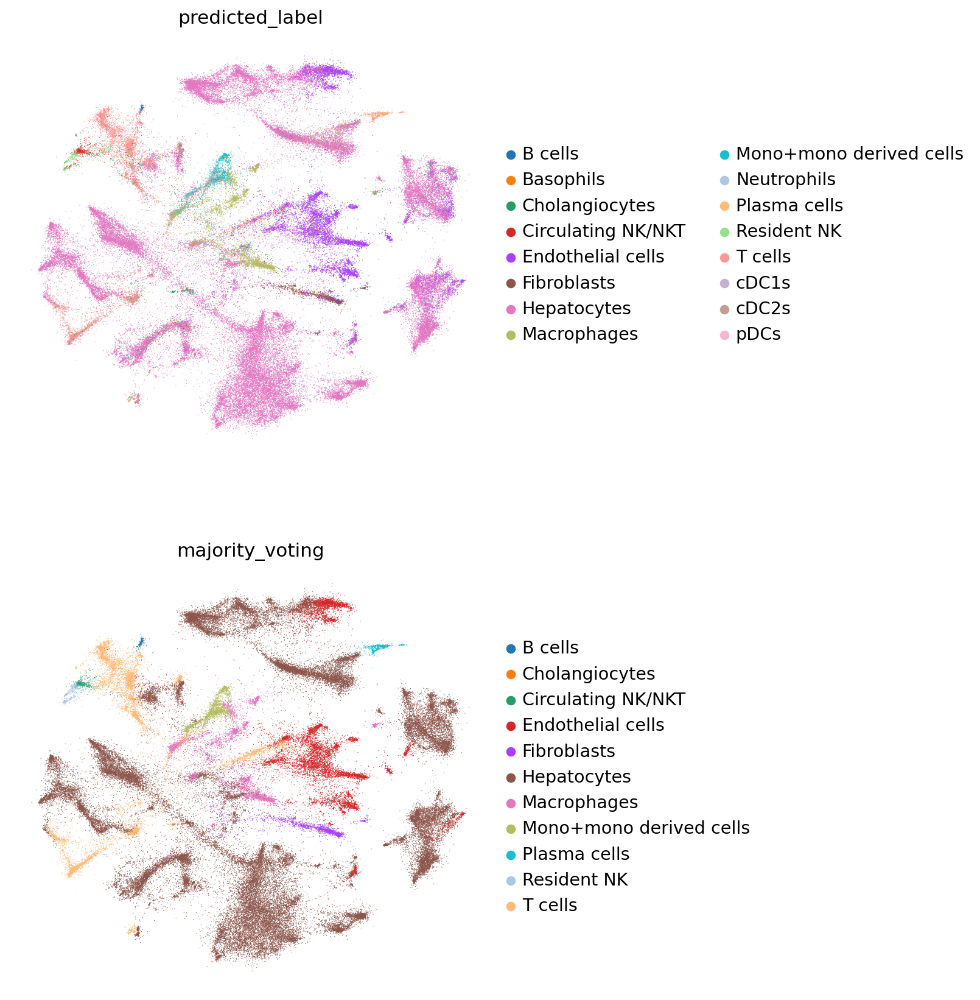

In [55]:
sc.pl.embedding(adata, basis=SCVI_MDE_KEY, color=["predicted_label", 'majority_voting'], frameon=False, ncols=1)

In [56]:
adata.write_h5ad('/home/mcgonzalez/Servicio_Social/Data/adata_saved/probe_annotatedCells_2024a.h5ad')